<h1>Libraries And Utilities</h1>

In [ ]:
!pip3 install tensorflow==2.8
!pip3 install lime
!pip3 install shap==0.40.0
!pip3 install numba

In [ ]:
from numba import cuda

device = cuda.get_current_device()
device.reset()

In [1]:
import sys, os, glob, pathlib, shap, warnings, shutil, time
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from lime import lime_image
from skimage.segmentation import mark_boundaries
from skimage.io import imread, imsave
from skimage.util import crop
from skimage.transform import resize

from sklearn.metrics import confusion_matrix, accuracy_score, precision_score, recall_score, f1_score, matthews_corrcoef, roc_auc_score

warnings.filterwarnings(action="ignore", message="^internal gelsd")

import tensorflow as tf
from tensorflow.keras.applications.resnet50 import ResNet50
from tensorflow.keras.applications.resnet50 import preprocess_input as preprocess_input_resnet
from tensorflow.keras.applications.mobilenet_v2 import MobileNetV2
from tensorflow.keras.applications.mobilenet_v2 import preprocess_input as preprocess_input_mobilenet
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.applications.vgg16 import preprocess_input as preprocess_input_vgg16
from tensorflow.keras.applications.inception_v3 import InceptionV3
from tensorflow.keras.applications.inception_v3 import preprocess_input as preprocess_input_inceptionV3
from tensorflow.keras.models import Sequential
from tensorflow.keras import layers, Model, Input, utils
from tensorflow.keras.preprocessing import image_dataset_from_directory, image
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import SparseCategoricalCrossentropy, KLDivergence
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.data.experimental import cardinality

from google.colab import drive
drive.mount('/content/drive')

sys.path.insert(0,'/content/drive/MyDrive/tese_mestrado_JoseMauricio_ISEC/utils')
from gradCam import read_and_transform_img, make_gradcam_heatmap_CNN, display_gradcam
from distillation import Distiller
from occlusion_maps import OcclusionMaps
from rise import RISE

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


<h1>Load Dataset</h1>

In [ ]:
!unzip -q '/content/drive/MyDrive/tese_mestrado_JoseMauricio_ISEC/datasets/dataset_CD_UC_v4.zip'

In [ ]:
#Crop images
for url in glob.glob('/content/dataset_CD_UC/ulcerative-colitis-crop/*.jpg'):
  img = imread(url)
  crop_img = crop(img, ((0, 179), (25, 0), (0,0)), copy=False)
  imsave('/content/dataset_CD_UC/ulcerative-colitis/'+url.split('/')[4], crop_img)

In [ ]:
os.mkdir('/content/frames/frames_train')
os.mkdir('/content/frames/frames_test')

os.mkdir('/content/frames/frames_train/crohn-disease')
os.mkdir('/content/frames/frames_train/ulcerative-colitis')

os.mkdir('/content/frames/frames_test/crohn-disease')
os.mkdir('/content/frames/frames_test/ulcerative-colitis')

In [ ]:
#Crop frames
for url in glob.glob('/content/frames-crop/*.jpg'):
  img = imread(url)
  crop_img = crop(img, ((0, 179), (25, 0), (0,0)), copy=False)
  imsave('/content/frames/frames_test/ulcerative-colitis/'+url.split('/')[3], crop_img)


list_files = [name for name in glob.glob('/content/frames/ulcerative-colitis/*.jpg')]
for a in list_files:
  shutil.move(a, '/content/frames/frames_train/ulcerative-colitis/')

In [ ]:
os.rmdir(pathlib.Path('/content/frames/ulcerative-colitis'))
!rm -r '/content/dataset_CD_UC/ulcerative-colitis-crop/'
!rm -r '/content/frames-crop/'

In [2]:
data_dir = pathlib.Path('/content/dataset_CD_UC')
data_dir_frames_train = pathlib.Path('/content/frames/frames_train')
data_dir_frames_test = pathlib.Path('/content/frames/frames_test')

# Input size initial
batch_size = 32

IMG_SIZE = (224, 224)

train_ds = image_dataset_from_directory(
  data_dir,
  validation_split=0.7,
  subset="training",
  seed=123,
  shuffle=True,
  image_size=IMG_SIZE,
  batch_size=batch_size)

val_ds = image_dataset_from_directory(
  data_dir,
  validation_split=0.3,
  subset="validation",
  seed=123,
  shuffle=True,
  image_size=IMG_SIZE,
  batch_size=batch_size)

val_batches = cardinality(val_ds)
test_ds = val_ds.take((2*val_batches) // 3)    #Take 20% for test
val_ds = val_ds.skip((2*val_batches) // 3)   #Take 10% for validation

class_names = train_ds.class_names

print(class_names)

Found 2205 files belonging to 2 classes.
Using 662 files for training.
Found 2205 files belonging to 2 classes.
Using 661 files for validation.
['crohn-disease', 'ulcerative-colitis']


In [3]:
frames_train = image_dataset_from_directory(data_dir_frames_train,image_size=IMG_SIZE,batch_size=batch_size)
frames_test = image_dataset_from_directory(data_dir_frames_test,image_size=IMG_SIZE,batch_size=batch_size)

train_ds = train_ds.concatenate(frames_train)
test_ds = test_ds.concatenate(frames_test)

Found 34 files belonging to 2 classes.
Found 30 files belonging to 2 classes.


Found 2205 files belonging to 2 classes.


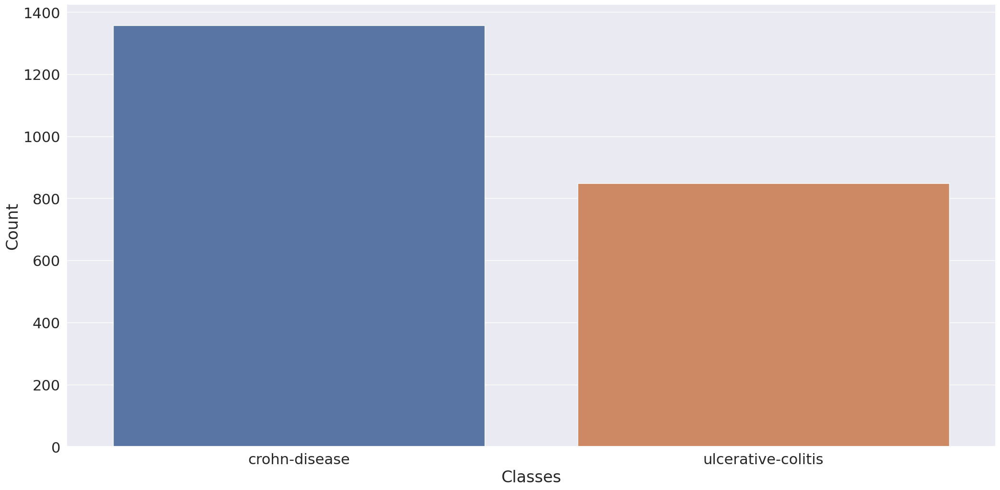

In [ ]:
def class_distribution(dataset):
    class_values = []
    total_batches = dataset.__len__().numpy()
    for batch, element in enumerate(dataset.as_numpy_iterator()):
        if batch+1 == total_batches:
            for i in range(len(element[1])):
                class_values.append(class_names[int(element[1][i])])
        else:
            for i in range(batch_size):
                class_values.append(class_names[int(element[1][i])])

    class_n, frequency = np.unique(np.array(class_values), return_counts=True)
    count = pd.DataFrame(columns=["Classes","Count"])
    count["Classes"] = class_n
    count["Count"] = frequency
    return count, class_values

dataset1 = image_dataset_from_directory(data_dir)

df_class_dist, class_df_values_val = class_distribution(dataset1)
plt.figure(figsize=(25, 12))
sns.set(font_scale=2.0)
sns.barplot(data=df_class_dist, y="Count" ,x="Classes");
plt.show()

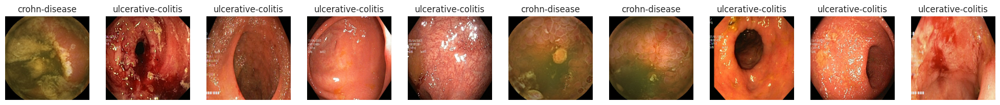

In [ ]:
plt.figure(figsize=(25, 15))
for images, labels in train_ds.take(1):
    for i in range(10):
        ax = plt.subplot(2, 10, i + 1)
        sns.set(font_scale=1.0)
        plt.imshow(images[i].numpy().astype("uint8"))
        plt.title(class_names[labels[i]])
        plt.axis("off")

<h1>Classificiation</h1>

In [4]:
data_augmentation = Sequential([
  layers.RandomFlip("horizontal_and_vertical"),
  layers.RandomRotation(0.2),
  layers.RandomContrast(0.15),
  layers.RandomZoom(-.2,-.3)
])

In [5]:
early_stopping = EarlyStopping(monitor='val_accuracy', patience=5)
sns.set(font_scale=1.0)

In [6]:
images, labels = tuple(zip(*val_ds))

true_images = np.concatenate(images)
true_labels = np.concatenate(labels)

<h1>Student model</h1>

In [ ]:
inputs = Input(shape=IMG_SIZE + (3,))
x = data_augmentation(inputs)
x = layers.Conv2D(filters=32, kernel_size=3, activation='relu', padding = 'same')(x)
x = layers.Conv2D(filters=32, kernel_size=3, activation='relu', padding = 'same')(x)
x = layers.BatchNormalization()(x)
x = layers.MaxPooling2D()(x)
x = layers.Conv2D(filters=64, kernel_size=3, activation='relu', padding = 'same')(x)
x = layers.Conv2D(filters=64, kernel_size=3, activation='relu', padding = 'same')(x)
x = layers.BatchNormalization()(x)
x = layers.MaxPooling2D()(x)
x = layers.Conv2D(filters=128, kernel_size=3, activation='relu', padding = 'same')(x)
x = layers.Conv2D(filters=128, kernel_size=3, activation='relu', padding = 'same')(x)
x = layers.MaxPooling2D()(x)
x = layers.Conv2D(filters=256, kernel_size=3, activation='relu', padding = 'same')(x)
x = layers.Conv2D(filters=256, kernel_size=3, activation='relu', padding = 'same')(x)
x = layers.GlobalAveragePooling2D()(x)
x = layers.Dense(128, activation='relu')(x)
x = layers.Dense(128, activation='relu')(x)
x = layers.Dropout(0.5)(x)
x = layers.Dense(128, activation='relu')(x)
x = layers.Dense(64, activation='relu')(x)
x = layers.Dropout(0.5)(x)
x = layers.Dense(64, activation='relu')(x)
x = layers.Dense(48, activation='relu')(x)
outputs = layers.Dense(len(class_names))(x)
student_model = Model(inputs, outputs)

In [ ]:
student_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 sequential (Sequential)     (None, 224, 224, 3)       0         
                                                                 
 conv2d (Conv2D)             (None, 224, 224, 32)      896       
                                                                 
 conv2d_1 (Conv2D)           (None, 224, 224, 32)      9248      
                                                                 
 batch_normalization (BatchN  (None, 224, 224, 32)     128       
 ormalization)                                                   
                                                                 
 max_pooling2d (MaxPooling2D  (None, 112, 112, 32)     0         
 )                                                           

<h1>Images to Interpretability</h1>

In [ ]:
for url in glob.glob('/content/test/ulcerative-colitis-crop/*.jpg'):
  img = imread(url)
  crop_img = crop(img, ((0, 179), (25, 0), (0,0)), copy=False)
  imsave('/content/test/ulcerative-colitis/'+url.split('/')[4], crop_img)

In [ ]:
!rm -r '/content/test/ulcerative-colitis-crop/'

In [7]:
dir = pathlib.Path('/content/test')
interpretability_data = image_dataset_from_directory(dir, image_size=IMG_SIZE, batch_size=batch_size)
print(interpretability_data.class_names)

images_exp, labels_exp = tuple(zip(*interpretability_data))

image_interpretability_4 = np.concatenate(images_exp)
labels_interpretability_4 = np.concatenate(labels_exp)

Found 6 files belonging to 2 classes.
['crohn-disease', 'ulcerative-colitis']


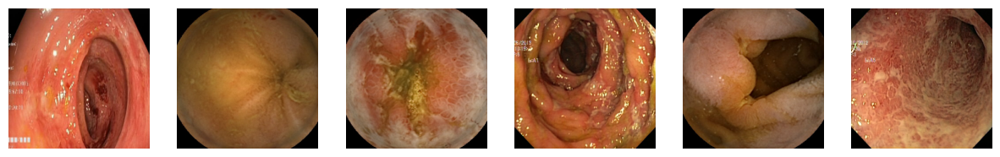

In [8]:
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)
    
  ax.imshow(img_array[0].astype(np.uint8))
  ax.axis('off')

In [9]:
print('*** Ground truth ***\n')
for val in labels_interpretability_4:
  if val == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

*** Ground truth ***

ulcerative-colitis
crohn-disease
crohn-disease
ulcerative-colitis
crohn-disease
ulcerative-colitis


# AlexNet

In [ ]:
model_alexnet = Sequential([
    data_augmentation,
    layers.Conv2D(filters=96, kernel_size=(11,11), strides=(4,4), activation='relu', input_shape=(224,224,3)),
    layers.BatchNormalization(),
    layers.MaxPool2D(pool_size=(3,3), strides=(2,2)),
    layers.Conv2D(filters=256, kernel_size=(5,5), strides=(1,1), activation='relu', padding="same"),
    layers.BatchNormalization(),
    layers.MaxPool2D(pool_size=(3,3), strides=(2,2)),
    layers.Conv2D(filters=384, kernel_size=(3,3), strides=(1,1), activation='relu', padding="same"),
    layers.BatchNormalization(),
    layers.Conv2D(filters=384, kernel_size=(3,3), strides=(1,1), activation='relu', padding="same"),
    layers.BatchNormalization(),
    layers.Conv2D(filters=256, kernel_size=(3,3), strides=(1,1), activation='relu', padding="same"),
    layers.BatchNormalization(),
    layers.MaxPool2D(pool_size=(3,3), strides=(2,2)),
    layers.Flatten(),
    layers.Dense(4096, activation='relu'),
    layers.Dropout(0.5),
    layers.Dense(4096, activation='relu'),
    layers.Dropout(0.5),
    layers.Dense(len(class_names))
])

In [ ]:
model_alexnet.build((None, 224, 224,3))
model_alexnet.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 sequential (Sequential)     (None, 224, 224, 3)       0         
                                                                 
 conv2d_8 (Conv2D)           (None, 54, 54, 96)        34944     
                                                                 
 batch_normalization_2 (Batc  (None, 54, 54, 96)       384       
 hNormalization)                                                 
                                                                 
 max_pooling2d_3 (MaxPooling  (None, 26, 26, 96)       0         
 2D)                                                             
                                                                 
 conv2d_9 (Conv2D)           (None, 26, 26, 256)       614656    
                                                                 
 batch_normalization_3 (Batc  (None, 26, 26, 256)     

In [ ]:
model_alexnet.compile(loss=SparseCategoricalCrossentropy(from_logits=True), optimizer=Adam(learning_rate=1e-5), metrics=['accuracy'])

In [ ]:
history = model_alexnet.fit(train_ds, epochs=200, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/200
23/23 [==============================] - 16s 203ms/step - loss: 1.1430 - accuracy: 0.6954 - val_loss: 1.7997 - val_accuracy: 0.4268
Epoch 2/200
23/23 [==============================] - 3s 123ms/step - loss: 0.5424 - accuracy: 0.8463 - val_loss: 1.2898 - val_accuracy: 0.4331
Epoch 3/200
23/23 [==============================] - 3s 124ms/step - loss: 0.4016 - accuracy: 0.9023 - val_loss: 1.0576 - val_accuracy: 0.4351
Epoch 4/200
23/23 [==============================] - 5s 196ms/step - loss: 0.2081 - accuracy: 0.9353 - val_loss: 0.7184 - val_accuracy: 0.5628
Epoch 5/200
23/23 [==============================] - 4s 124ms/step - loss: 0.2049 - accuracy: 0.9425 - val_loss: 0.3899 - val_accuracy: 0.7699
Epoch 6/200
23/23 [==============================] - 3s 121ms/step - loss: 0.2046 - accuracy: 0.9497 - val_loss: 0.2806 - val_accuracy: 0.8452
Epoch 7/200
23/23 [==============================] - 4s 162ms/step - loss: 0.1084 - accuracy: 0.9641 - val_loss: 0.1421 - val_accuracy: 0.958

<Axes: >

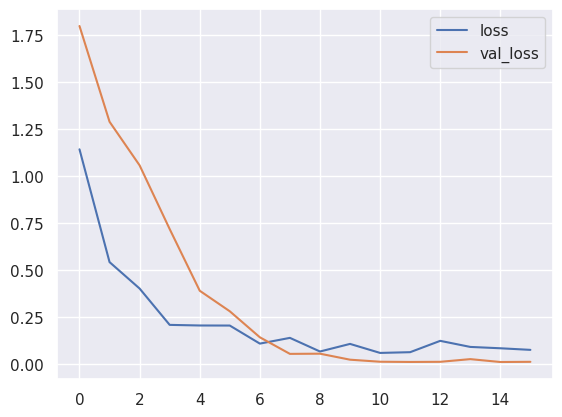

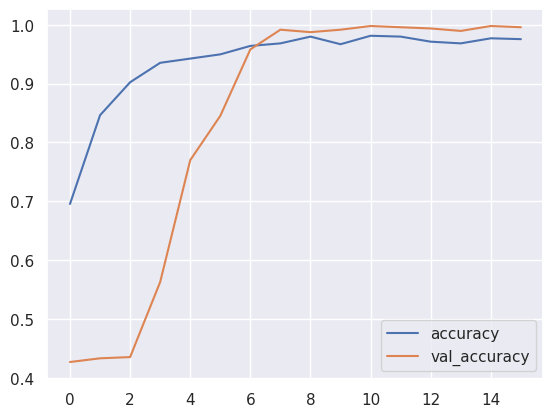

In [ ]:
model_history = pd.DataFrame(history.history)
model_history.loc[:, ['loss', 'val_loss']].plot()
model_history.loc[:, ['accuracy', 'val_accuracy']].plot()

In [ ]:
print('Accuracy for Train: {:.4f}'.format(model_history['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(model_history['loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(model_history['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(model_history['val_loss'].mean()))

Accuracy for Train: 0.9378
Loss for Train: 0.2262
Accuracy for Test: 0.8358
Loss for Test: 0.3682


In [ ]:
start = time.time()
predict_labels_ = model_alexnet.predict(true_images)
duration = time.time() - start

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_1 = tf.reshape(true_labels, (-1,))
loss = loss_object(true_labels_1,predict_labels_)

predict_labels = np.argmax(model_alexnet.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels)))
print("Loss: {:0.4f}".format(loss))
print("Inference Time: {:.2f}s".format(duration))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels)))

Accuracy: 1.0000
Loss: 0.0031
Inference Time: 0.75s
Precision: 1.0000
Recall: 1.0000
F1-Score: 1.0000
AUC: 1.0000
MCC: 1.0000


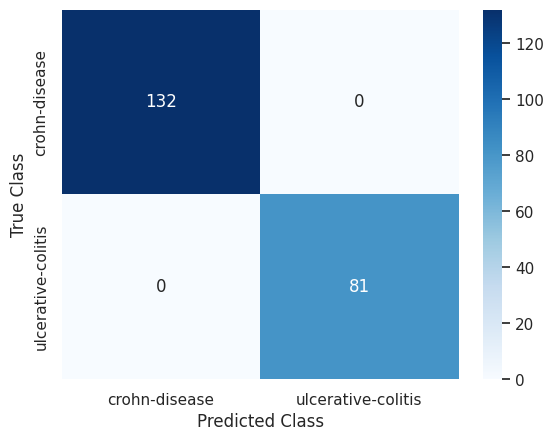

In [ ]:
conf_matrix = pd.DataFrame(confusion_matrix(true_labels, predict_labels), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [ ]:
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)

  preds = model_alexnet.predict(img_array)
  if np.argmax(preds, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

crohn-disease
ulcerative-colitis
crohn-disease
ulcerative-colitis
ulcerative-colitis
crohn-disease


<h1>Knowledge Distillation</h1>

In [ ]:
distillation_ = Distiller(student=student_model, teacher=model_alexnet)

distillation_.compile(
    optimizer=Adam(learning_rate=1e-4),
    metrics=['accuracy'],
    student_loss_fn=SparseCategoricalCrossentropy(from_logits=True), 
    distillation_loss_fn=KLDivergence(),
    alpha=0.8,
    temperature=105)

In [ ]:
distillation_history = distillation_.fit(train_ds, epochs=100, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/100
23/23 [==============================] - 14s 406ms/step - accuracy: 0.6178 - student_loss: 0.6876 - distillation_loss: 29.0076 - val_accuracy: 0.4268 - val_student_loss: 0.5224
Epoch 2/100
23/23 [==============================] - 6s 251ms/step - accuracy: 0.8147 - student_loss: 0.6205 - distillation_loss: 27.2022 - val_accuracy: 0.4351 - val_student_loss: 9.7399e-04
Epoch 3/100
23/23 [==============================] - 6s 231ms/step - accuracy: 0.9267 - student_loss: 0.2008 - distillation_loss: 14.7066 - val_accuracy: 0.4351 - val_student_loss: 7.1923e-07
Epoch 4/100
23/23 [==============================] - 6s 260ms/step - accuracy: 0.9813 - student_loss: 0.0670 - distillation_loss: 9.6299 - val_accuracy: 0.4414 - val_student_loss: 0.0000e+00
Epoch 5/100
23/23 [==============================] - 6s 228ms/step - accuracy: 0.9641 - student_loss: 0.1120 - distillation_loss: 13.3852 - val_accuracy: 0.4331 - val_student_loss: 9.9341e-08
Epoch 6/100
23/23 [=========================

<Axes: >

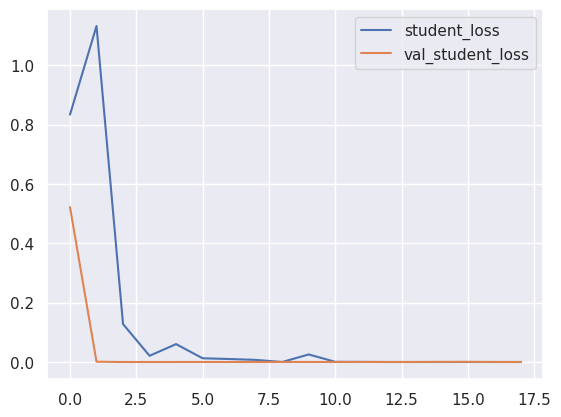

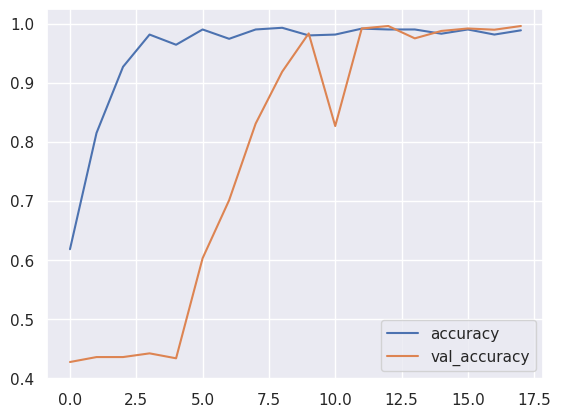

In [ ]:
distiller_history = pd.DataFrame(distillation_history.history)
distiller_history.loc[:, ['student_loss', 'val_student_loss']].plot()
distiller_history.loc[:, ['accuracy', 'val_accuracy']].plot()

In [ ]:
print('Accuracy for Train: {:.4f}'.format(distiller_history['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(distiller_history['student_loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(distiller_history['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(distiller_history['val_student_loss'].mean()))

Accuracy for Train: 0.9515
Loss for Train: 0.1240
Accuracy for Test: 0.7756
Loss for Test: 0.0292


In [ ]:
start_dist = time.time()
predict_labels_dist = distillation_.predict(true_images)
duration_dist = time.time() - start_dist

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_dist = tf.reshape(true_labels, (-1,))
loss_dist = loss_object(true_labels_dist,predict_labels_dist)

predict_labels_distiller = np.argmax(distillation_.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_distiller)))
print("Loss: {:0.4f}".format(loss_dist))
print("Inference Time: {:.2f}s".format(duration_dist))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_distiller)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_distiller)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_distiller)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_distiller)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_distiller)))

Accuracy: 1.0000
Loss: 0.0026
Inference Time: 2.51s
Precision: 1.0000
Recall: 1.0000
F1-Score: 1.0000
AUC: 1.0000
MCC: 1.0000


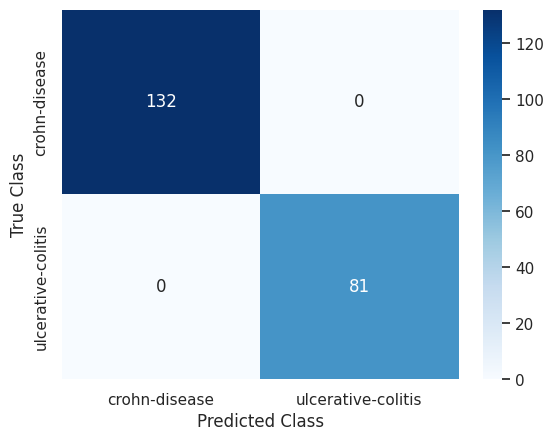

In [ ]:
conf_matrix_distiller = pd.DataFrame(confusion_matrix(true_labels, predict_labels_distiller), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_distiller, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [ ]:
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)

  preds_dist = distillation_.predict(img_array)
  if np.argmax(preds_dist, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

crohn-disease
ulcerative-colitis
crohn-disease
ulcerative-colitis
ulcerative-colitis
crohn-disease


<h1>Interpretability of Teacher</h1>

<h3>Grad-Cam</h3>

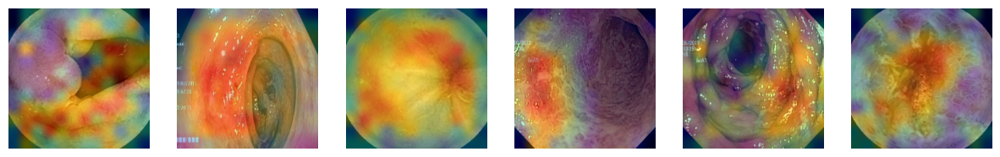

In [ ]:
last_conv_layer_name = "conv2d_12"

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)

  model_alexnet.layers[-1].activation = None

  preds = model_alexnet.predict(img_array)
  heatmap = make_gradcam_heatmap_CNN(img_array, model_alexnet, last_conv_layer_name)

  heatmap = np.reshape(heatmap, (-1,12))
  display_gradcam(_images, heatmap, preds=preds[0], plot=ax)

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

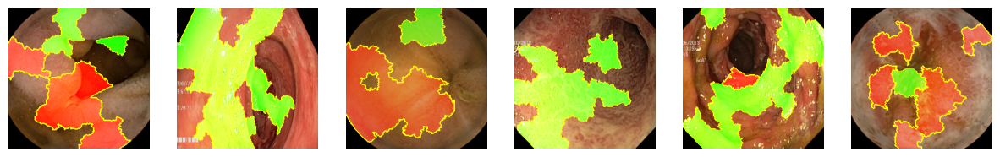

In [ ]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)
    
  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), model_alexnet.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>Shapley Values</h3>

array([[[[0.0000000e+00, 0.0000000e+00, 0.0000000e+00],
         [0.0000000e+00, 0.0000000e+00, 0.0000000e+00],
         [0.0000000e+00, 0.0000000e+00, 0.0000000e+00],
         ...,
         [0.0000000e+00, 0.0000000e+00, 0.0000000e+00],
         [0.0000000e+00, 0.0000000e+00, 0.0000000e+00],
         [0.0000000e+00, 0.0000000e+00, 0.0000000e+00]],

        [[0.0000000e+00, 0.0000000e+00, 0.0000000e+00],
         [0.0000000e+00, 0.0000000e+00, 0.0000000e+00],
         [0.0000000e+00, 0.0000000e+00, 0.0000000e+00],
         ...,
         [0.0000000e+00, 0.0000000e+00, 0.0000000e+00],
         [0.0000000e+00, 0.0000000e+00, 0.0000000e+00],
         [0.0000000e+00, 0.0000000e+00, 0.0000000e+00]],

        [[0.0000000e+00, 0.0000000e+00, 0.0000000e+00],
         [0.0000000e+00, 0.0000000e+00, 0.0000000e+00],
         [0.0000000e+00, 0.0000000e+00, 0.0000000e+00],
         ...,
         [0.0000000e+00, 0.0000000e+00, 0.0000000e+00],
         [0.0000000e+00, 0.0000000e+00, 0.0000000e+00],
  

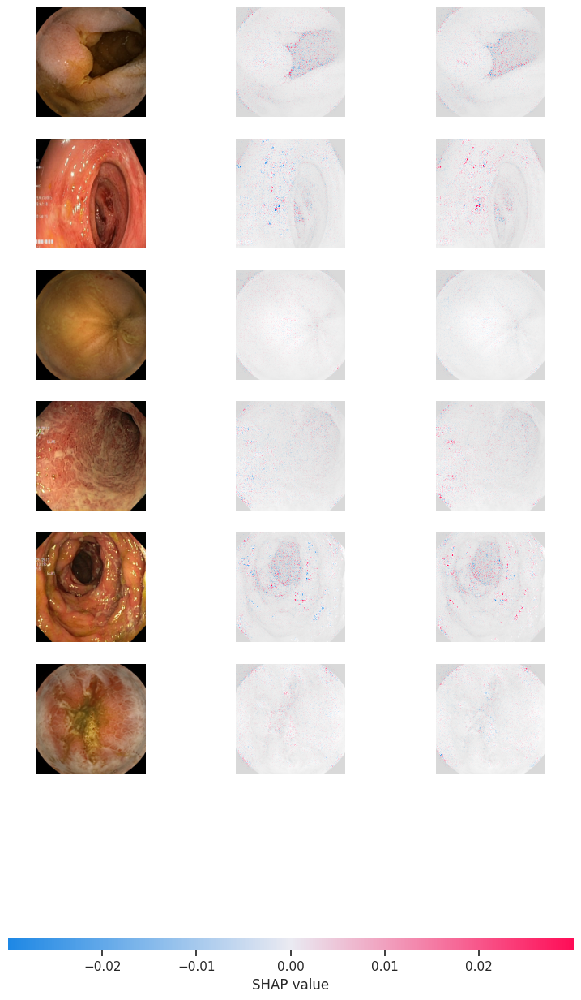

In [ ]:
images_train, labels_train = tuple(zip(*train_ds))
images_train_1 = np.concatenate(images_train)

shap_values = shap.GradientExplainer(model_alexnet, images_train_1).shap_values(image_interpretability_4)
shap.image_plot(shap_values, image_interpretability_4)

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [ ]:
model_rise = RISE(1000, 8, 0.5, model_alexnet, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:02<00:00, 372.68it/s]


Explaining: 100%|██████████| 32/32 [00:03<00:00,  8.16it/s]


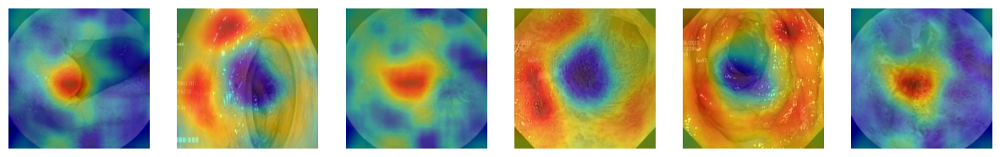

In [ ]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_4[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

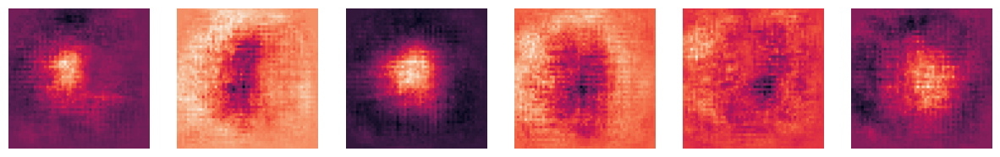

In [ ]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap_occ = occ.get_heatmap(model_alexnet, 4, int(labels_interpretability_4[idx]), IMG_SIZE[0])

  ax.imshow(heatmap_occ)
  # ax.imshow(_images.astype(np.uint8), cmap='gray')
  # ax.pcolormesh(heatmap_occ, cmap='jet', alpha=0.35)
  ax.axis('off')

  idx += 1

<h1>Interpretability of Student</h1>

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

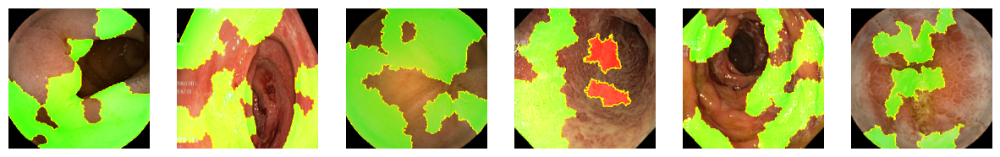

In [ ]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)
    
  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), distillation_.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [ ]:
model_rise = RISE(1000, 8, 0.5, distillation_, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:02<00:00, 430.66it/s]


Explaining: 100%|██████████| 32/32 [00:03<00:00,  8.18it/s]


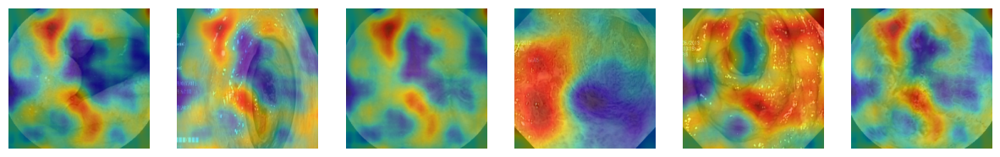

In [ ]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_4[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

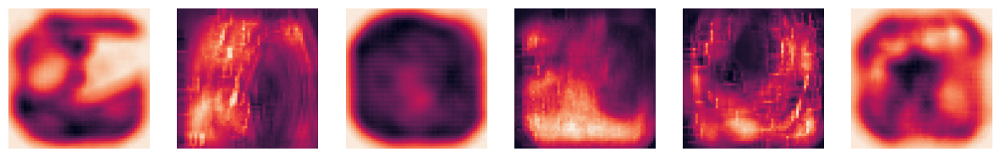

In [ ]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap = occ.get_heatmap(distillation_, 4, int(labels_interpretability_4[idx]), IMG_SIZE[0])

  ax.imshow(heatmap)
  # ax.imshow(_images.astype(np.uint8), cmap=plt.cm.gray)
  # ax.pcolormesh(heatmap, cmap=plt.cm.jet, alpha=0.20)
  ax.axis('off')

  idx += 1

# ResNet50

In [ ]:
inputs = Input(shape=(224, 224, 3))
x = data_augmentation(inputs)
x = preprocess_input_resnet(x)
x = ResNet50(weights='imagenet', include_top=False, pooling='avg', input_tensor=x)
outputs = layers.Dense(len(class_names))(x.output)
model_resnet50 = Model(inputs, outputs)

94781440/94765736 [==============================] - 1s 0us/step


In [ ]:
model_resnet50.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 sequential (Sequential)        (None, 224, 224, 3)  0           ['input_2[0][0]']                
                                                                                                  
 tf.__operators__.getitem (Slic  (None, 224, 224, 3)  0          ['sequential[1][0]']             
 ingOpLambda)                                                                                     
                                                                                            

In [ ]:
model_resnet50.compile(loss=SparseCategoricalCrossentropy(from_logits=True), optimizer=Adam(learning_rate=1e-5), metrics=['accuracy'])

In [ ]:
history_resnet50 = model_resnet50.fit(train_ds, epochs=200, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/200
23/23 [==============================] - 30s 579ms/step - loss: 0.4773 - accuracy: 0.7486 - val_loss: 0.3829 - val_accuracy: 0.8033
Epoch 2/200
23/23 [==============================] - 11s 444ms/step - loss: 0.1709 - accuracy: 0.9526 - val_loss: 0.1866 - val_accuracy: 0.9623
Epoch 3/200
23/23 [==============================] - 10s 419ms/step - loss: 0.1006 - accuracy: 0.9770 - val_loss: 0.1382 - val_accuracy: 0.9854
Epoch 4/200
23/23 [==============================] - 11s 460ms/step - loss: 0.0800 - accuracy: 0.9784 - val_loss: 0.1046 - val_accuracy: 0.9916
Epoch 5/200
23/23 [==============================] - 11s 437ms/step - loss: 0.0633 - accuracy: 0.9842 - val_loss: 0.0839 - val_accuracy: 0.9958
Epoch 6/200
23/23 [==============================] - 11s 420ms/step - loss: 0.0639 - accuracy: 0.9756 - val_loss: 0.0638 - val_accuracy: 1.0000
Epoch 7/200
23/23 [==============================] - 11s 442ms/step - loss: 0.0487 - accuracy: 0.9871 - val_loss: 0.0530 - val_accuracy:

<Axes: >

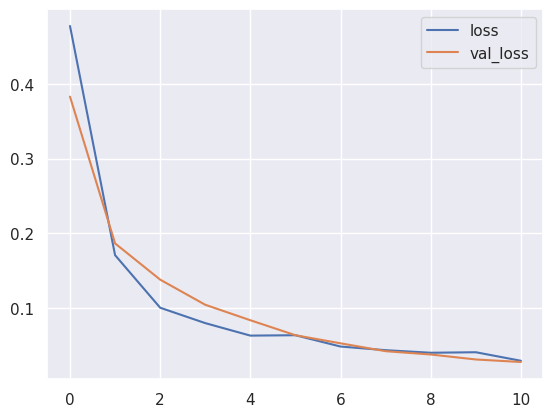

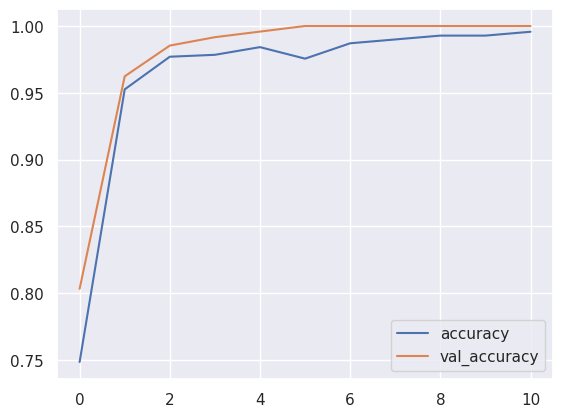

In [ ]:
model_history_resnet50 = pd.DataFrame(history_resnet50.history)
model_history_resnet50.loc[:, ['loss', 'val_loss']].plot()
model_history_resnet50.loc[:, ['accuracy', 'val_accuracy']].plot()

In [ ]:
print('Accuracy for Train: {:.4f}'.format(model_history_resnet50['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(model_history_resnet50['loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(model_history_resnet50['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(model_history_resnet50['val_loss'].mean()))

Accuracy for Train: 0.9613
Loss for Train: 0.1054
Accuracy for Test: 0.9762
Loss for Test: 0.1048


In [ ]:
start = time.time()
predict_labels_ = model_resnet50.predict(true_images)
duration = time.time() - start

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_1 = tf.reshape(true_labels, (-1,))
loss = loss_object(true_labels_1,predict_labels_)

predict_labels_resnet50 = np.argmax(model_resnet50.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_resnet50)))
print("Loss: {:0.4f}".format(loss))
print("Inference Time: {:.2f}s".format(duration))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_resnet50)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_resnet50)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_resnet50)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_resnet50)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_resnet50)))

Accuracy: 1.0000
Loss: 0.0297
Inference Time: 3.65s
Precision: 1.0000
Recall: 1.0000
F1-Score: 1.0000
AUC: 1.0000
MCC: 1.0000


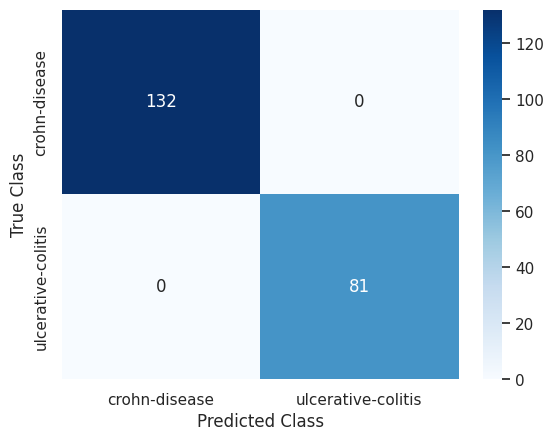

In [ ]:
conf_matrix_resnet50 = pd.DataFrame(confusion_matrix(true_labels, predict_labels_resnet50), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_resnet50, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [ ]:
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)

  preds = model_resnet50.predict(img_array)
  if np.argmax(preds, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

ulcerative-colitis
crohn-disease
ulcerative-colitis
crohn-disease
crohn-disease
ulcerative-colitis


<h1>Knowledge Distillation</h1>

In [ ]:
distillation_ = Distiller(student=student_model, teacher=model_resnet50)

distillation_.compile(
    optimizer=Adam(learning_rate=1e-4),
    metrics=['accuracy'],
    student_loss_fn=SparseCategoricalCrossentropy(from_logits=True), 
    distillation_loss_fn=KLDivergence(),
    alpha=0.8,
    temperature=105)

In [ ]:
distillation_history = distillation_.fit(train_ds, epochs=100, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/100
23/23 [==============================] - 19s 511ms/step - accuracy: 0.6193 - student_loss: 0.6771 - distillation_loss: 8.6352 - val_accuracy: 0.5732 - val_student_loss: 0.7092
Epoch 2/100
23/23 [==============================] - 8s 321ms/step - accuracy: 0.7845 - student_loss: 0.4770 - distillation_loss: 8.1281 - val_accuracy: 0.4351 - val_student_loss: 0.4972
Epoch 3/100
23/23 [==============================] - 9s 351ms/step - accuracy: 0.9109 - student_loss: 0.2810 - distillation_loss: 6.3875 - val_accuracy: 0.4414 - val_student_loss: 1.0842e-04
Epoch 4/100
23/23 [==============================] - 8s 306ms/step - accuracy: 0.9425 - student_loss: 0.1718 - distillation_loss: 3.4456 - val_accuracy: 0.4372 - val_student_loss: 2.1047e-05
Epoch 5/100
23/23 [==============================] - 8s 314ms/step - accuracy: 0.9511 - student_loss: 0.1383 - distillation_loss: 3.0273 - val_accuracy: 0.4289 - val_student_loss: 2.3666e-04
Epoch 6/100
23/23 [==============================] -

<Axes: >

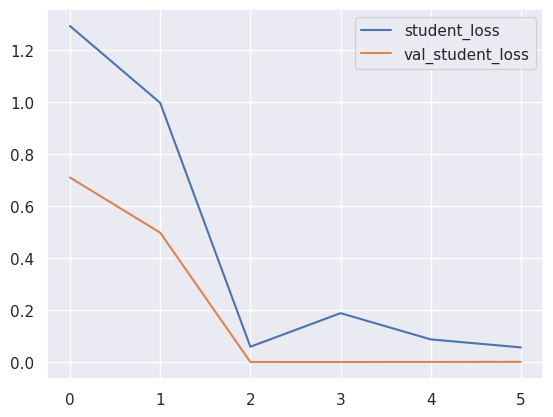

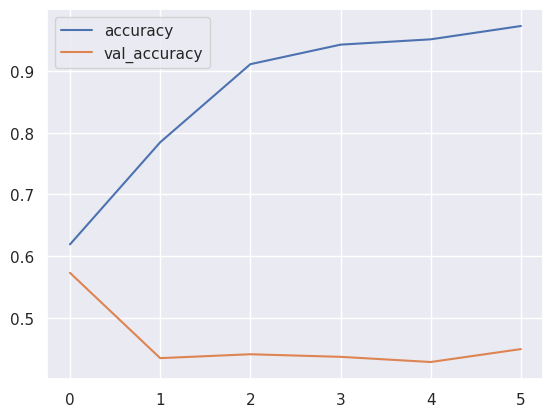

In [ ]:
distiller_history = pd.DataFrame(distillation_history.history)
distiller_history.loc[:, ['student_loss', 'val_student_loss']].plot()
distiller_history.loc[:, ['accuracy', 'val_accuracy']].plot()

In [ ]:
print('Accuracy for Train: {:.4f}'.format(distiller_history['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(distiller_history['student_loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(distiller_history['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(distiller_history['val_student_loss'].mean()))

Accuracy for Train: 0.8635
Loss for Train: 0.4463
Accuracy for Test: 0.4609
Loss for Test: 0.2012


In [ ]:
start_dist = time.time()
predict_labels_dist = distillation_.predict(true_images)
duration_dist = time.time() - start_dist

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_dist = tf.reshape(true_labels, (-1,))
loss_dist = loss_object(true_labels_dist,predict_labels_dist)

predict_labels_distiller = np.argmax(distillation_.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_distiller)))
print("Loss: {:0.4f}".format(loss_dist))
print("Inference Time: {:.2f}s".format(duration_dist))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_distiller)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_distiller)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_distiller)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_distiller)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_distiller)))

Accuracy: 0.3991
Loss: 1.3687
Inference Time: 2.06s
Precision: 0.3876
Recall: 1.0000
F1-Score: 0.5586
AUC: 0.5152
MCC: 0.1084


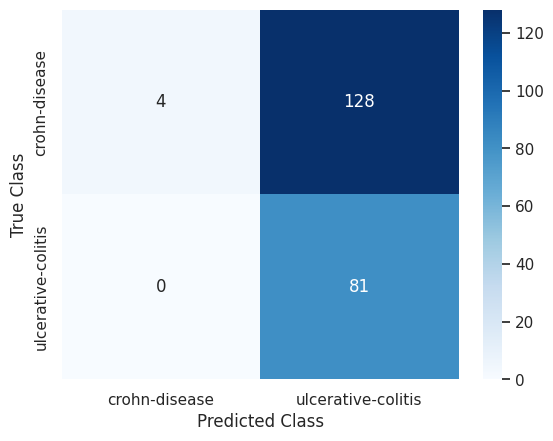

In [ ]:
conf_matrix_distiller = pd.DataFrame(confusion_matrix(true_labels, predict_labels_distiller), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_distiller, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [ ]:
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)

  preds_dist = distillation_.predict(img_array)
  if np.argmax(preds_dist, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

ulcerative-colitis
ulcerative-colitis
ulcerative-colitis
crohn-disease
ulcerative-colitis
ulcerative-colitis


<h1>Interpretability of Teacher</h1>

<h3>Grad-Cam</h3>

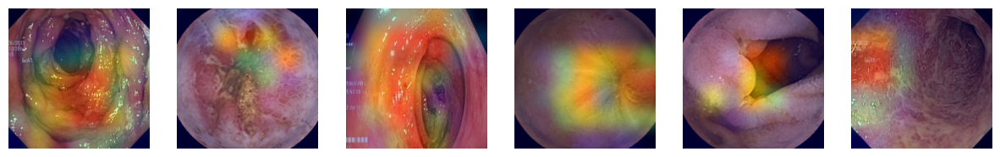

In [ ]:
last_conv_layer_name = "conv5_block3_3_conv"

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)

  model_resnet50.layers[-1].activation = None

  preds = model_resnet50.predict(img_array)
  heatmap = make_gradcam_heatmap_CNN(img_array, model_resnet50, last_conv_layer_name)

  heatmap = np.reshape(heatmap, (-1,7))
  display_gradcam(_images, heatmap, preds=preds[0], plot=ax)

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

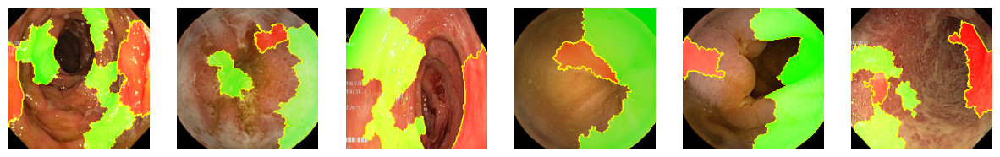

In [ ]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)
    
  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), model_resnet50.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>Shap Values</h3>

`tf.keras.backend.set_learning_phase` is deprecated and will be removed after 2020-10-11. To update it, simply pass a True/False value to the `training` argument of the `__call__` method of your layer or model.


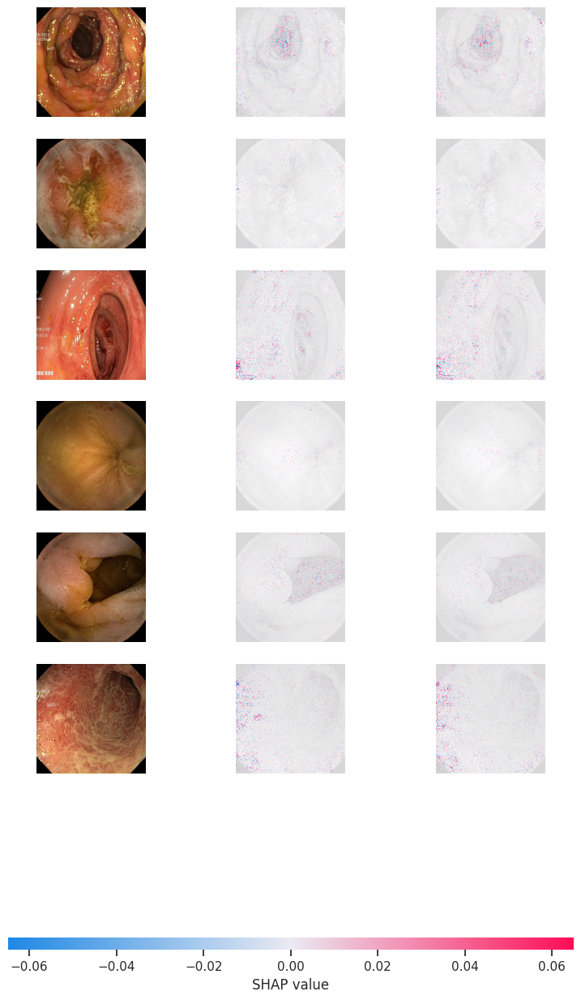

In [ ]:
images_train, labels_train = tuple(zip(*train_ds))
images_train_1 = np.concatenate(images_train)

shap_values = shap.GradientExplainer(model_resnet50, images_train_1).shap_values(image_interpretability_4)
shap.image_plot(shap_values, image_interpretability_4)

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [ ]:
model_rise = RISE(1000, 8, 0.5, model_resnet50, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:03<00:00, 289.19it/s]


Explaining: 100%|██████████| 32/32 [00:05<00:00,  5.65it/s]


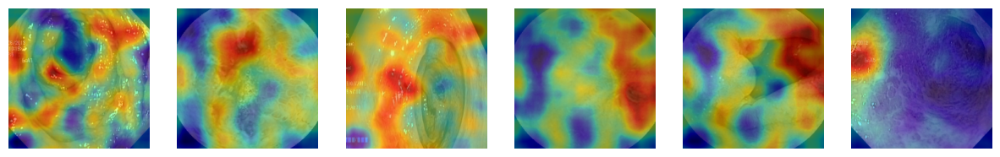

In [ ]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_4[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

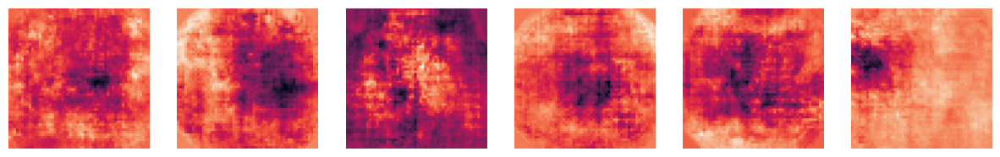

In [ ]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap_occ = occ.get_heatmap(model_resnet50, 4, int(labels_interpretability_4[idx]), IMG_SIZE[0])

  ax.imshow(heatmap_occ)
  ax.axis('off')

  idx += 1

<h1>Interpretability of Student</h1>

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

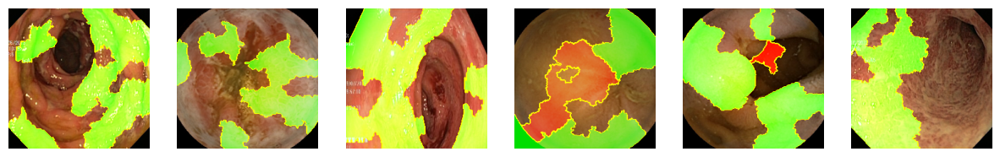

In [ ]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)
    
  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), distillation_.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [ ]:
model_rise = RISE(1000, 8, 0.5, distillation_, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:02<00:00, 414.37it/s]


Explaining: 100%|██████████| 32/32 [00:03<00:00,  9.57it/s]


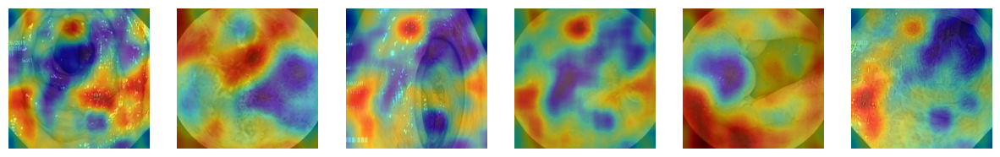

In [ ]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_4[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

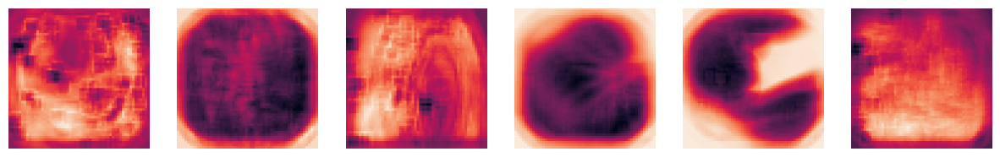

In [ ]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap_occ_1 = occ.get_heatmap(distillation_, 4, int(labels_interpretability_4[idx]), IMG_SIZE[0])

  ax.imshow(heatmap_occ_1)
  ax.axis('off')

  idx += 1

# VGG16

In [ ]:
inputs = Input(shape=(224,224,3))
x = data_augmentation(inputs)
x = preprocess_input_vgg16(x)
x = VGG16(weights='imagenet', include_top=False, input_tensor=x)
x = layers.Flatten()(x.output)
x = layers.Dense(4096,activation='relu')(x)
x = layers.Dense(4096,activation='relu')(x)
outputs = layers.Dense(len(class_names))(x)
model_vgg16 = Model(inputs, outputs)

58900480/58889256 [==============================] - 1s 0us/step


In [ ]:
model_vgg16.summary()

Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 sequential (Sequential)     (None, 224, 224, 3)       0         
                                                                 
 tf.__operators__.getitem (S  (None, 224, 224, 3)      0         
 licingOpLambda)                                                 
                                                                 
 tf.nn.bias_add (TFOpLambda)  (None, 224, 224, 3)      0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                           

In [ ]:
model_vgg16.compile(loss=SparseCategoricalCrossentropy(from_logits=True), optimizer=Adam(learning_rate=1e-5), metrics=['accuracy'])

In [ ]:
history_vgg = model_vgg16.fit(train_ds, epochs=200, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/200
23/23 [==============================] - 36s 1s/step - loss: 0.5618 - accuracy: 0.8980 - val_loss: 0.0324 - val_accuracy: 0.9854
Epoch 2/200
23/23 [==============================] - 15s 651ms/step - loss: 0.0998 - accuracy: 0.9770 - val_loss: 0.0162 - val_accuracy: 0.9895
Epoch 3/200
23/23 [==============================] - 16s 676ms/step - loss: 0.0088 - accuracy: 0.9957 - val_loss: 0.0099 - val_accuracy: 0.9958
Epoch 4/200
23/23 [==============================] - 16s 672ms/step - loss: 0.0092 - accuracy: 0.9943 - val_loss: 0.0107 - val_accuracy: 0.9937
Epoch 5/200
23/23 [==============================] - 16s 660ms/step - loss: 0.0076 - accuracy: 0.9971 - val_loss: 0.0027 - val_accuracy: 0.9979
Epoch 6/200
23/23 [==============================] - 15s 641ms/step - loss: 0.0024 - accuracy: 0.9986 - val_loss: 0.0018 - val_accuracy: 0.9979
Epoch 7/200
23/23 [==============================] - 16s 647ms/step - loss: 0.0021 - accuracy: 1.0000 - val_loss: 1.7178e-04 - val_accuracy

<Axes: >

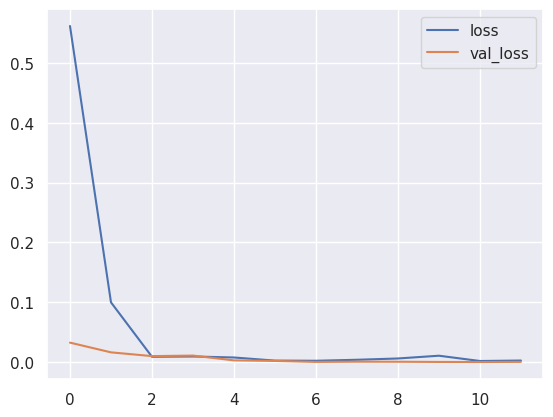

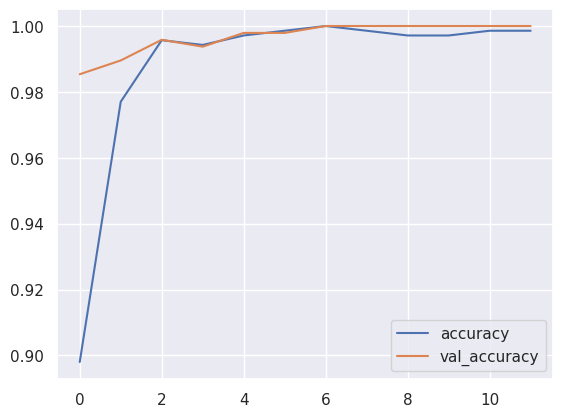

In [ ]:
model_history_vgg = pd.DataFrame(history_vgg.history)
model_history_vgg.loc[:, ['loss', 'val_loss']].plot()
model_history_vgg.loc[:, ['accuracy', 'val_accuracy']].plot()

In [ ]:
print('Accuracy for Train: {:.4f}'.format(model_history_vgg['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(model_history_vgg['loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(model_history_vgg['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(model_history_vgg['val_loss'].mean()))

Accuracy for Train: 0.9875
Loss for Train: 0.0597
Accuracy for Test: 0.9967
Loss for Test: 0.0063


In [ ]:
start = time.time()
predict_labels_ = model_vgg16.predict(true_images)
duration = time.time() - start

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_1 = tf.reshape(true_labels, (-1,))
loss = loss_object(true_labels_1,predict_labels_)

predict_labels_vgg = np.argmax(model_vgg16.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_vgg)))
print("Loss: {:0.4f}".format(loss))
print("Inference Time: {:.2f}s".format(duration))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_vgg)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_vgg)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_vgg)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_vgg)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_vgg)))

Accuracy: 1.0000
Loss: 0.0016
Inference Time: 3.80s
Precision: 1.0000
Recall: 1.0000
F1-Score: 1.0000
AUC: 1.0000
MCC: 1.0000


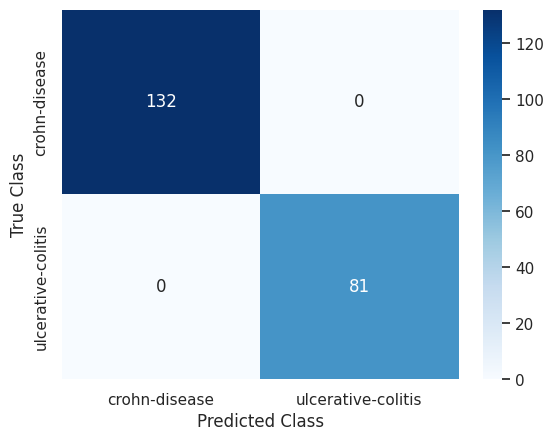

In [ ]:
conf_matrix_vgg = pd.DataFrame(confusion_matrix(true_labels, predict_labels_vgg), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_vgg, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [ ]:
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)

  preds = model_vgg16.predict(img_array)
  if np.argmax(preds, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

crohn-disease
ulcerative-colitis
crohn-disease
ulcerative-colitis
crohn-disease
ulcerative-colitis


<h1>Knowledge Distillation</h1>

In [ ]:
distillation_ = Distiller(student=student_model, teacher=model_vgg16)

distillation_.compile(
    optimizer=Adam(learning_rate=1e-4),
    metrics=['accuracy'],
    student_loss_fn=SparseCategoricalCrossentropy(from_logits=True), 
    distillation_loss_fn=KLDivergence(),
    alpha=0.8,
    temperature=105)

In [ ]:
distillation_history = distillation_.fit(train_ds, epochs=100, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/100
23/23 [==============================] - 19s 613ms/step - accuracy: 0.5905 - student_loss: 0.7559 - distillation_loss: 121.6550 - val_accuracy: 0.5649 - val_student_loss: 0.7140
Epoch 2/100
23/23 [==============================] - 10s 411ms/step - accuracy: 0.6322 - student_loss: 1.8685 - distillation_loss: 108.9215 - val_accuracy: 0.7008 - val_student_loss: 0.6935
Epoch 3/100
23/23 [==============================] - 10s 395ms/step - accuracy: 0.6911 - student_loss: 0.8806 - distillation_loss: 89.1559 - val_accuracy: 0.4519 - val_student_loss: 0.4683
Epoch 4/100
23/23 [==============================] - 11s 439ms/step - accuracy: 0.7845 - student_loss: 0.5227 - distillation_loss: 75.2265 - val_accuracy: 0.6234 - val_student_loss: 0.2262
Epoch 5/100
23/23 [==============================] - 10s 401ms/step - accuracy: 0.9095 - student_loss: 0.2823 - distillation_loss: 72.6260 - val_accuracy: 0.4310 - val_student_loss: 4.7580e-04
Epoch 6/100
23/23 [==============================

<Axes: >

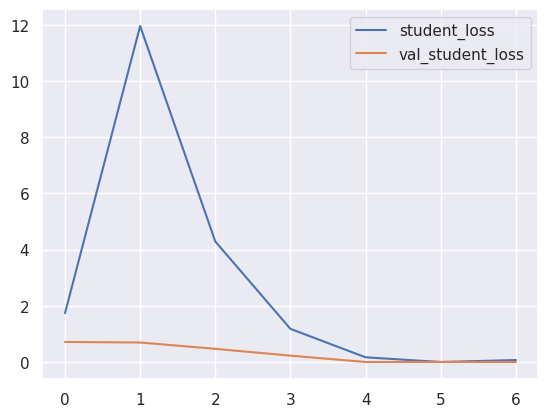

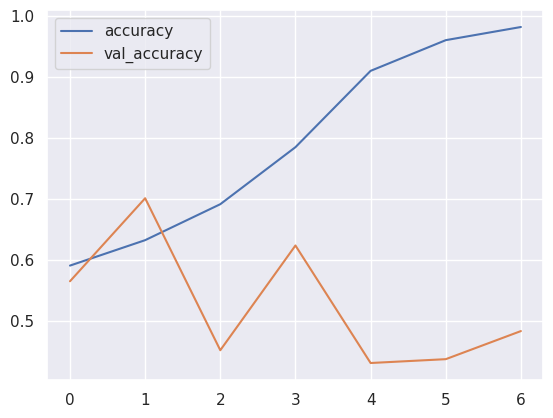

In [ ]:
distiller_history = pd.DataFrame(distillation_history.history)
distiller_history.loc[:, ['student_loss', 'val_student_loss']].plot()
distiller_history.loc[:, ['accuracy', 'val_accuracy']].plot()

In [ ]:
print('Accuracy for Train: {:.4f}'.format(distiller_history['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(distiller_history['student_loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(distiller_history['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(distiller_history['val_student_loss'].mean()))

Accuracy for Train: 0.7927
Loss for Train: 2.7708
Accuracy for Test: 0.5275
Loss for Test: 0.3003


In [ ]:
start_dist = time.time()
predict_labels_dist = distillation_.predict(true_images)
duration_dist = time.time() - start_dist

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_dist = tf.reshape(true_labels, (-1,))
loss_dist = loss_object(true_labels_dist,predict_labels_dist)

predict_labels_distiller = np.argmax(distillation_.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_distiller)))
print("Loss: {:0.4f}".format(loss_dist))
print("Inference Time: {:.2f}s".format(duration_dist))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_distiller)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_distiller)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_distiller)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_distiller)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_distiller)))

Accuracy: 0.4272
Loss: 2.6307
Inference Time: 1.61s
Precision: 0.3990
Recall: 1.0000
F1-Score: 0.5704
AUC: 0.5379
MCC: 0.1739


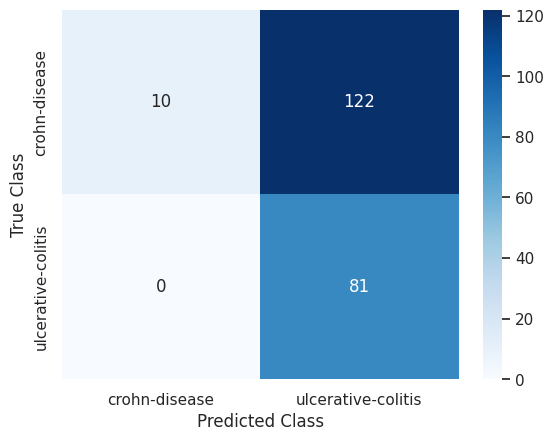

In [ ]:
conf_matrix_distiller = pd.DataFrame(confusion_matrix(true_labels, predict_labels_distiller), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_distiller, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [ ]:
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)

  preds_dist = distillation_.predict(img_array)
  if np.argmax(preds_dist, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

ulcerative-colitis
ulcerative-colitis
ulcerative-colitis
ulcerative-colitis
ulcerative-colitis
ulcerative-colitis


<h1>Interpretability of Teacher</h1>

<h3>Grad-Cam</h3>

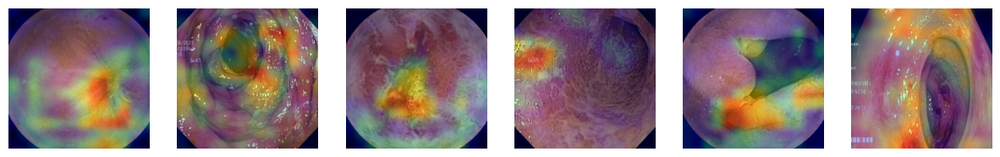

In [ ]:
last_conv_layer_name = "block5_conv3"

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)

  model_vgg16.layers[-1].activation = None

  preds = model_vgg16.predict(img_array)
  heatmap = make_gradcam_heatmap_CNN(img_array, model_vgg16, last_conv_layer_name)

  heatmap = np.reshape(heatmap, (-1,14))
  display_gradcam(_images, heatmap, preds=preds[0], plot=ax)

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

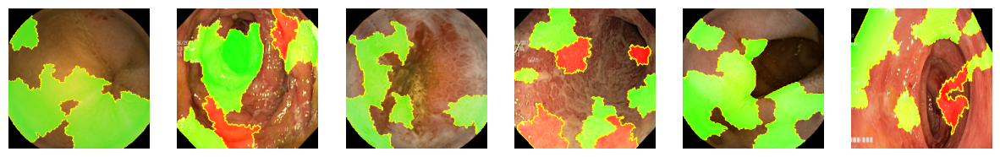

In [ ]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)
    
  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), model_vgg16.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>Shapley Values</h3>

`tf.keras.backend.set_learning_phase` is deprecated and will be removed after 2020-10-11. To update it, simply pass a True/False value to the `training` argument of the `__call__` method of your layer or model.


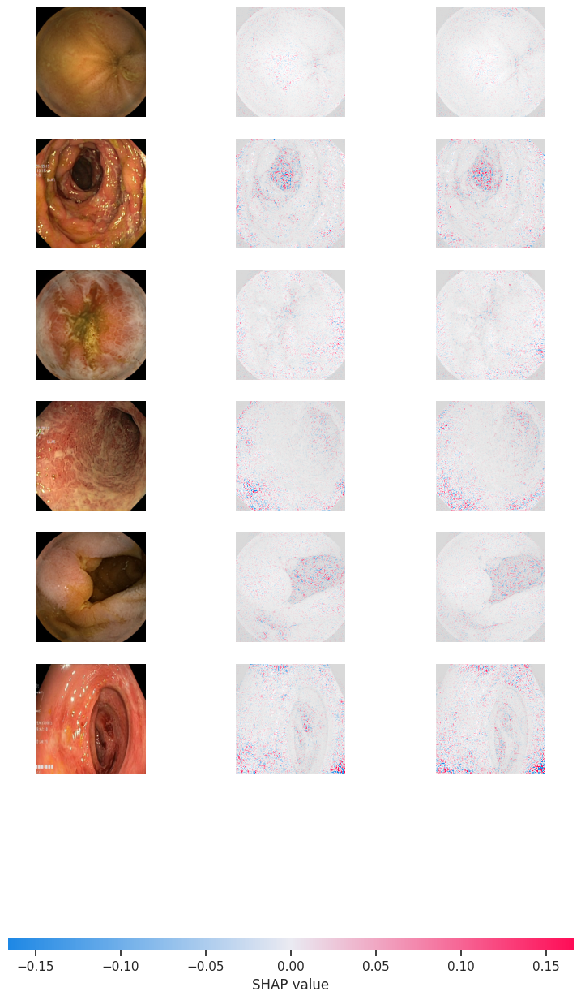

In [ ]:
images_train, labels_train = tuple(zip(*train_ds))
images_train_1 = np.concatenate(images_train)

shap_values = shap.GradientExplainer(model_vgg16, images_train_1).shap_values(image_interpretability_4)
shap.image_plot(shap_values, image_interpretability_4)

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [ ]:
model_rise = RISE(1000, 8, 0.5, model_vgg16, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:03<00:00, 328.56it/s]


Explaining: 100%|██████████| 32/32 [00:09<00:00,  3.37it/s]


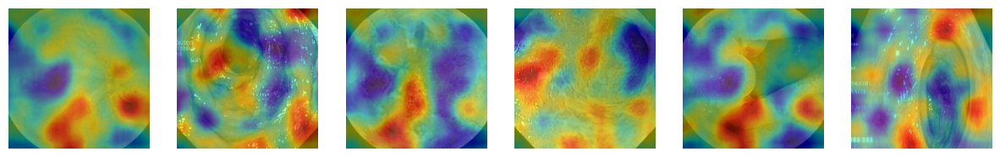

In [ ]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_4[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

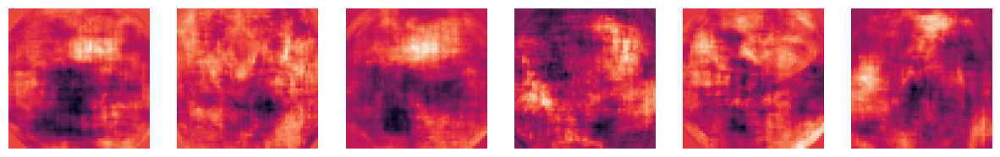

In [ ]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap = occ.get_heatmap(model_vgg16, 4, int(labels_interpretability_4[idx]), IMG_SIZE[0])

  ax.imshow(heatmap)
  ax.axis('off')

  idx += 1

<h1>Interpretability of Student</h1>

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

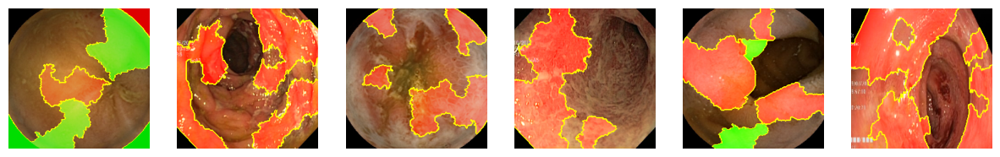

In [ ]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)
    
  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), distillation_.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [ ]:
model_rise = RISE(1000, 8, 0.5, distillation_, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:02<00:00, 347.53it/s]


Explaining: 100%|██████████| 32/32 [00:03<00:00,  8.79it/s]


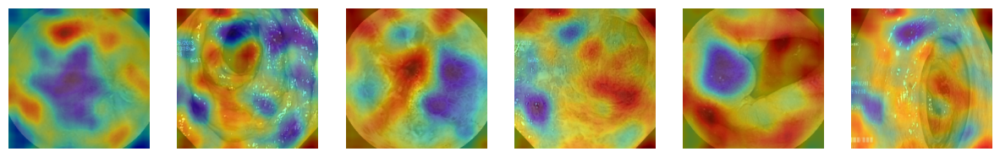

In [ ]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_4[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

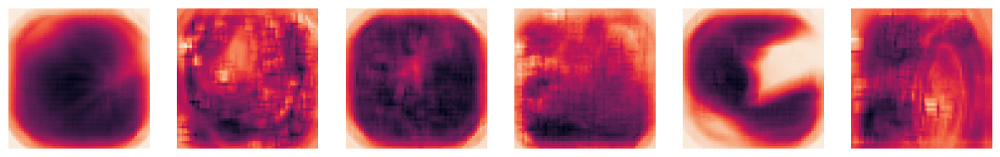

In [ ]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap = occ.get_heatmap(distillation_, 4, int(labels_interpretability_4[idx]), IMG_SIZE[0])

  ax.imshow(heatmap)
  ax.axis('off')

  idx += 1

# InceptionV3

In [ ]:
inputs = Input(shape=(224,224,3))
x = data_augmentation(inputs)
x = preprocess_input_inceptionV3(x)
x = InceptionV3(weights='imagenet', pooling='avg', include_top=False, input_tensor=x)
outputs = layers.Dense(len(class_names))(x.output)
model_inceptionV3 = Model(inputs, outputs)

87924736/87910968 [==============================] - 0s 0us/step


In [ ]:
model_inceptionV3.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 sequential (Sequential)        (None, 224, 224, 3)  0           ['input_2[0][0]']                
                                                                                                  
 tf.math.truediv (TFOpLambda)   (None, 224, 224, 3)  0           ['sequential[1][0]']             
                                                                                                  
 tf.math.subtract (TFOpLambda)  (None, 224, 224, 3)  0           ['tf.math.truediv[0][0]']  

In [ ]:
model_inceptionV3.compile(loss=SparseCategoricalCrossentropy(from_logits=True), optimizer=Adam(learning_rate=1e-5), metrics=['accuracy'])

In [ ]:
history_inceptionV3 = model_inceptionV3.fit(train_ds, epochs=200, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/200
23/23 [==============================] - 28s 642ms/step - loss: 0.6516 - accuracy: 0.6006 - val_loss: 0.5027 - val_accuracy: 0.7720
Epoch 2/200
23/23 [==============================] - 9s 380ms/step - loss: 0.4243 - accuracy: 0.8578 - val_loss: 0.3413 - val_accuracy: 0.8640
Epoch 3/200
23/23 [==============================] - 8s 323ms/step - loss: 0.2961 - accuracy: 0.9282 - val_loss: 0.2336 - val_accuracy: 0.9247
Epoch 4/200
23/23 [==============================] - 8s 326ms/step - loss: 0.2390 - accuracy: 0.9368 - val_loss: 0.1388 - val_accuracy: 0.9707
Epoch 5/200
23/23 [==============================] - 9s 370ms/step - loss: 0.1786 - accuracy: 0.9468 - val_loss: 0.1060 - val_accuracy: 0.9728
Epoch 6/200
23/23 [==============================] - 8s 328ms/step - loss: 0.1517 - accuracy: 0.9540 - val_loss: 0.0808 - val_accuracy: 0.9874
Epoch 7/200
23/23 [==============================] - 9s 343ms/step - loss: 0.1287 - accuracy: 0.9713 - val_loss: 0.0608 - val_accuracy: 0.995

<Axes: >

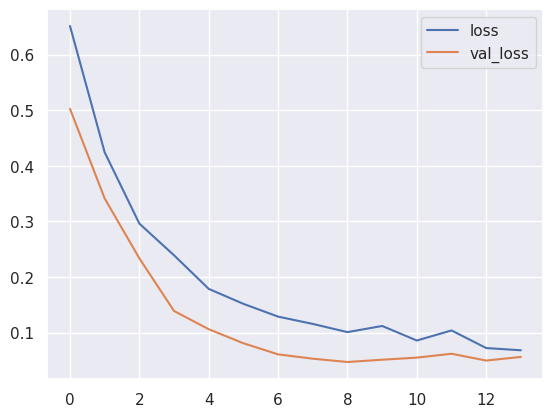

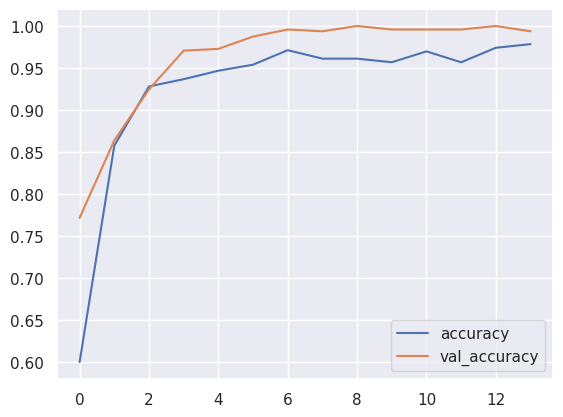

In [ ]:
model_history_inceptionV3 = pd.DataFrame(history_inceptionV3.history)
model_history_inceptionV3.loc[:, ['loss', 'val_loss']].plot()
model_history_inceptionV3.loc[:, ['accuracy', 'val_accuracy']].plot()

In [ ]:
print('Accuracy for Train: {:.4f}'.format(model_history_inceptionV3['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(model_history_inceptionV3['loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(model_history_inceptionV3['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(model_history_inceptionV3['val_loss'].mean()))

Accuracy for Train: 0.9253
Loss for Train: 0.1949
Accuracy for Test: 0.9616
Loss for Test: 0.1313


In [ ]:
start = time.time()
predict_labels_ = model_inceptionV3.predict(true_images)
duration = time.time() - start

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_1 = tf.reshape(true_labels, (-1,))
loss = loss_object(true_labels_1,predict_labels_)

predict_labels_inceptionV3 = np.argmax(model_inceptionV3.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_inceptionV3)))
print("Loss: {:0.4f}".format(loss))
print("Inference Time: {:.2f}s".format(duration))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_inceptionV3)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_inceptionV3)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_inceptionV3)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_inceptionV3)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_inceptionV3)))

Accuracy: 1.0000
Loss: 0.0596
Inference Time: 2.95s
Precision: 1.0000
Recall: 1.0000
F1-Score: 1.0000
AUC: 1.0000
MCC: 1.0000


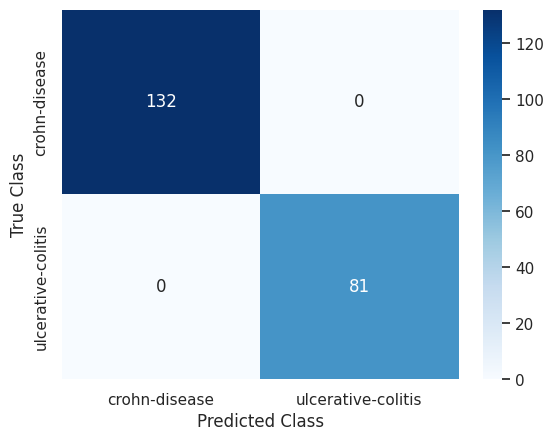

In [ ]:
conf_matrix_inceptionV3 = pd.DataFrame(confusion_matrix(true_labels, predict_labels_inceptionV3), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_inceptionV3, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [ ]:
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)

  preds = model_inceptionV3.predict(img_array)
  if np.argmax(preds, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

crohn-disease
ulcerative-colitis
crohn-disease
ulcerative-colitis
crohn-disease
ulcerative-colitis


<h1>Knowledge Distillation</h1>

In [ ]:
distillation_CNN = Distiller(student=student_model, teacher=model_inceptionV3)

distillation_CNN.compile(
    optimizer=Adam(learning_rate=1e-4),
    metrics=['accuracy'],
    student_loss_fn=SparseCategoricalCrossentropy(from_logits=True), 
    distillation_loss_fn=KLDivergence(),
    alpha=0.8,
    temperature=105)

In [ ]:
distillation_history_CNN = distillation_CNN.fit(train_ds, epochs=100, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/100
23/23 [==============================] - 20s 533ms/step - accuracy: 0.5761 - student_loss: 0.6447 - distillation_loss: 3.5512 - val_accuracy: 0.4372 - val_student_loss: 0.1144
Epoch 2/100
23/23 [==============================] - 8s 349ms/step - accuracy: 0.6997 - student_loss: 0.5097 - distillation_loss: 2.2758 - val_accuracy: 0.4289 - val_student_loss: 5.1339e-04
Epoch 3/100
23/23 [==============================] - 8s 302ms/step - accuracy: 0.8994 - student_loss: 0.3291 - distillation_loss: 1.6814 - val_accuracy: 0.4268 - val_student_loss: 8.4441e-04
Epoch 4/100
23/23 [==============================] - 8s 350ms/step - accuracy: 0.9598 - student_loss: 0.1994 - distillation_loss: 1.5134 - val_accuracy: 0.4351 - val_student_loss: 0.0023
Epoch 5/100
23/23 [==============================] - 7s 295ms/step - accuracy: 0.9698 - student_loss: 0.1780 - distillation_loss: 1.4752 - val_accuracy: 0.4351 - val_student_loss: 0.0021
Epoch 6/100
23/23 [==============================] - 9s 

<Axes: >

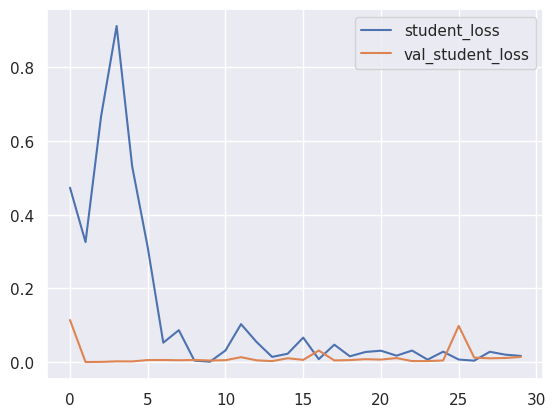

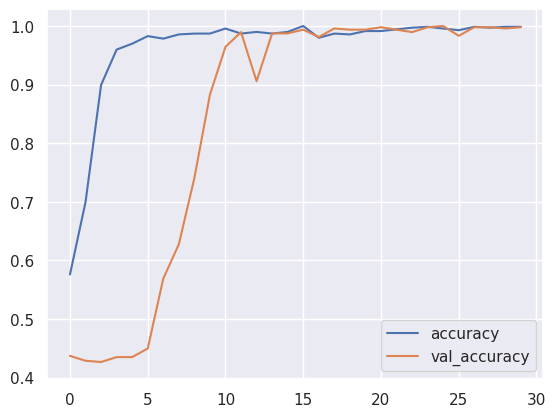

In [ ]:
distiller_history = pd.DataFrame(distillation_history_CNN.history)
distiller_history.loc[:, ['student_loss', 'val_student_loss']].plot()
distiller_history.loc[:, ['accuracy', 'val_accuracy']].plot()

In [ ]:
print('Accuracy for Train: {:.4f}'.format(distiller_history['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(distiller_history['student_loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(distiller_history['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(distiller_history['val_student_loss'].mean()))

Accuracy for Train: 0.9627
Loss for Train: 0.1318
Accuracy for Test: 0.8393
Loss for Test: 0.0139


In [ ]:
start_dist = time.time()
predict_labels_dist = distillation_CNN.predict(true_images)
duration_dist = time.time() - start_dist

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_dist = tf.reshape(true_labels, (-1,))
loss_dist = loss_object(true_labels_dist,predict_labels_dist)

predict_labels_distiller = np.argmax(distillation_CNN.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_distiller)))
print("Loss: {:0.4f}".format(loss_dist))
print("Inference Time: {:.2f}s".format(duration_dist))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_distiller)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_distiller)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_distiller)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_distiller)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_distiller)))

Accuracy: 1.0000
Loss: 0.0702
Inference Time: 1.45s
Precision: 1.0000
Recall: 1.0000
F1-Score: 1.0000
AUC: 1.0000
MCC: 1.0000


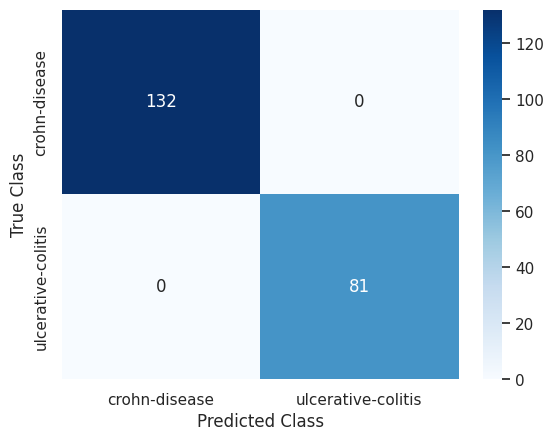

In [ ]:
conf_matrix_distiller = pd.DataFrame(confusion_matrix(true_labels, predict_labels_distiller), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_distiller, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [ ]:
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)

  preds_dist = distillation_CNN.predict(img_array)
  if np.argmax(preds_dist, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')


crohn-disease
ulcerative-colitis
crohn-disease
ulcerative-colitis
crohn-disease
ulcerative-colitis


<h1>Interpretability of Teacher</h1>

<h3>Grad-Cam</h3>

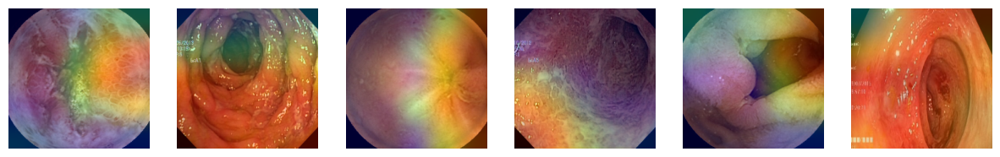

In [ ]:
last_conv_layer_name = "conv2d_101"

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)

  model_inceptionV3.layers[-1].activation = None

  preds = model_inceptionV3.predict(img_array)
  heatmap = make_gradcam_heatmap_CNN(img_array, model_inceptionV3, last_conv_layer_name)

  heatmap = np.reshape(heatmap, (-1,5))
  display_gradcam(_images, heatmap, preds=preds[0], plot=ax)

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

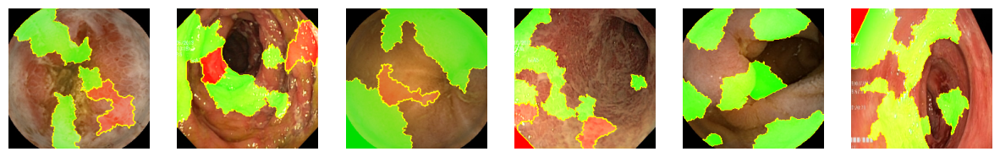

In [ ]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)
    
  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), model_inceptionV3.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>Shapley Values</h3>

`tf.keras.backend.set_learning_phase` is deprecated and will be removed after 2020-10-11. To update it, simply pass a True/False value to the `training` argument of the `__call__` method of your layer or model.


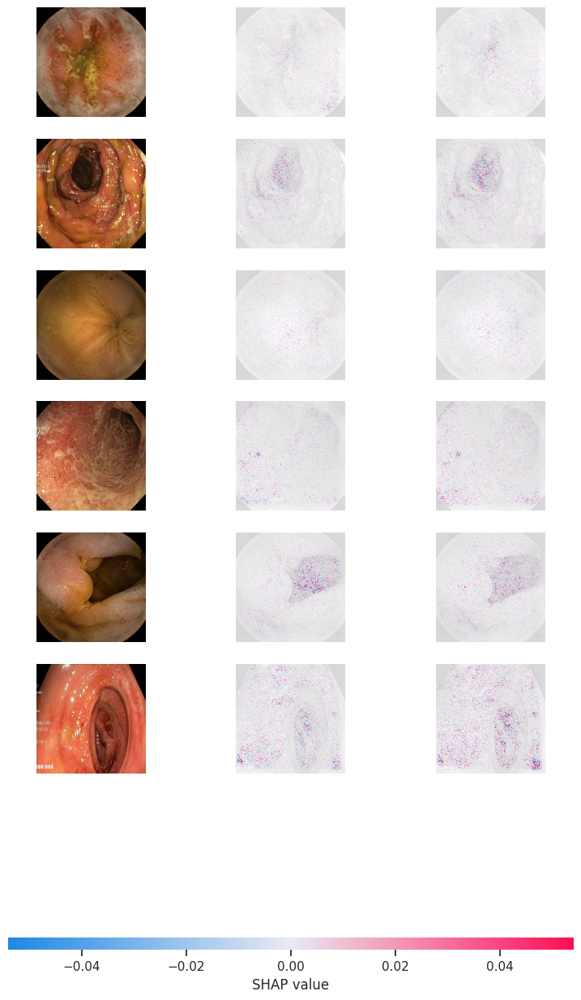

In [ ]:
images_train, labels_train = tuple(zip(*train_ds))
images_train_1 = np.concatenate(images_train)

shap_values = shap.GradientExplainer(model_inceptionV3, images_train_1).shap_values(image_interpretability_4)
shap.image_plot(shap_values, image_interpretability_4)

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [ ]:
model_rise = RISE(1000, 8, 0.5, model_inceptionV3, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:03<00:00, 273.50it/s]


Explaining: 100%|██████████| 32/32 [00:04<00:00,  6.46it/s]


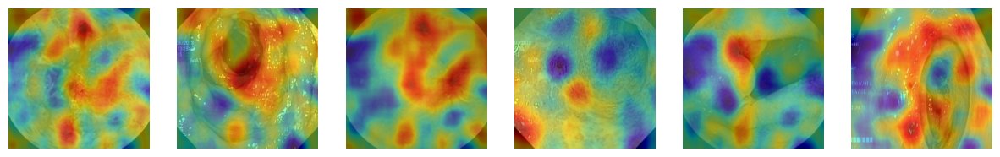

In [ ]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_4[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

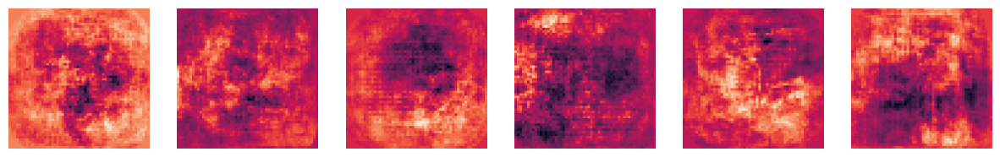

In [ ]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)

  occ = OcclusionMaps(_images)
  heatmap = occ.get_heatmap(model_inceptionV3, 4, int(labels_interpretability_4[idx]), IMG_SIZE[0])

  ax.imshow(heatmap)
  ax.axis('off')

  idx += 1

<h1>Interpretability of Student</h1>

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

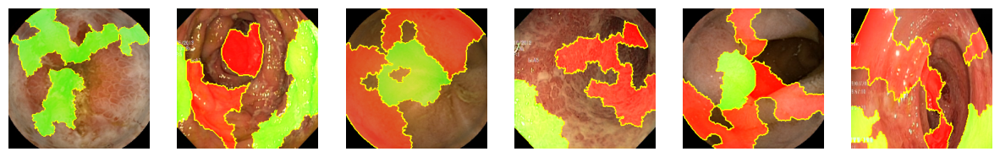

In [ ]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)
    
  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), distillation_CNN.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [ ]:
model_rise = RISE(1000, 8, 0.5, distillation_CNN, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:02<00:00, 395.38it/s]


Explaining: 100%|██████████| 32/32 [00:03<00:00,  9.00it/s]


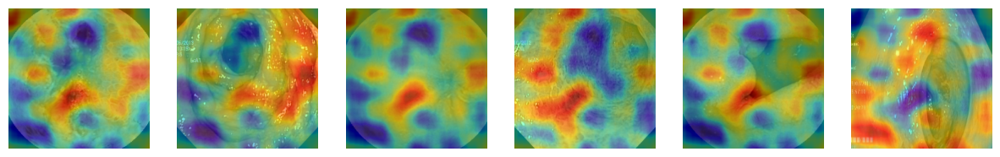

In [ ]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_4[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Maps</h3>

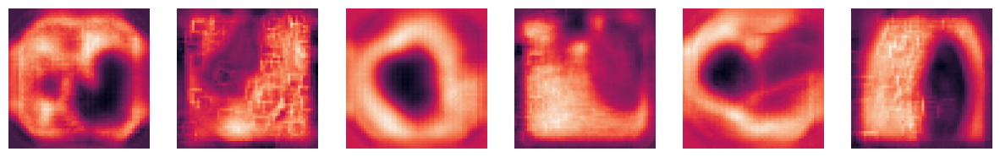

In [ ]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap = occ.get_heatmap(distillation_CNN, 4, int(labels_interpretability_4[idx]), IMG_SIZE[0])

  ax.imshow(heatmap)
  ax.axis('off')

  idx += 1

# Resnet50+MobileNetV2

In [ ]:
inputs_model = Input(shape=(224, 224, 3))
aug = data_augmentation(inputs_model)

preprocess_res = preprocess_input_resnet(aug)
outputs_model_1 = ResNet50(weights='imagenet', include_top=False, pooling='avg', input_tensor=preprocess_res)

preprocess_mobile = preprocess_input_mobilenet(aug)
outputs_model_2 = MobileNetV2(weights='imagenet', include_top=False, pooling='avg', input_tensor=preprocess_mobile)

merged_l = layers.Concatenate()([outputs_model_1.output,outputs_model_2.output])
output_layer = layers.Dense(2)(merged_l)

ensemble_method = Model(inputs=inputs_model,outputs=output_layer)

9420800/9406464 [==============================] - 0s 0us/step


In [ ]:
ensemble_method.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 sequential (Sequential)        (None, 224, 224, 3)  0           ['input_2[0][0]']                
                                                                                                  
 tf.__operators__.getitem (Slic  (None, 224, 224, 3)  0          ['sequential[1][0]']             
 ingOpLambda)                                                                                     
                                                                                            

In [ ]:
utils.plot_model(ensemble_method, show_shapes=True)

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
ensemble_method.compile(loss=SparseCategoricalCrossentropy(from_logits=True), optimizer=Adam(learning_rate=1e-5), metrics=['accuracy'])

In [ ]:
history_2 = ensemble_method.fit(train_ds, epochs=200, batch_size=32, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/200
23/23 [==============================] - 40s 1s/step - loss: 0.4671 - accuracy: 0.7773 - val_loss: 0.5097 - val_accuracy: 0.6904
Epoch 2/200
23/23 [==============================] - 16s 666ms/step - loss: 0.1712 - accuracy: 0.9497 - val_loss: 0.3405 - val_accuracy: 0.8410
Epoch 3/200
23/23 [==============================] - 16s 669ms/step - loss: 0.1170 - accuracy: 0.9713 - val_loss: 0.3015 - val_accuracy: 0.8661
Epoch 4/200
23/23 [==============================] - 15s 652ms/step - loss: 0.1018 - accuracy: 0.9713 - val_loss: 0.2387 - val_accuracy: 0.8996
Epoch 5/200
23/23 [==============================] - 16s 654ms/step - loss: 0.0796 - accuracy: 0.9770 - val_loss: 0.2180 - val_accuracy: 0.9205
Epoch 6/200
23/23 [==============================] - 16s 680ms/step - loss: 0.0826 - accuracy: 0.9741 - val_loss: 0.2003 - val_accuracy: 0.9351
Epoch 7/200
23/23 [==============================] - 16s 649ms/step - loss: 0.0614 - accuracy: 0.9842 - val_loss: 0.1786 - val_accuracy: 0.

<Axes: >

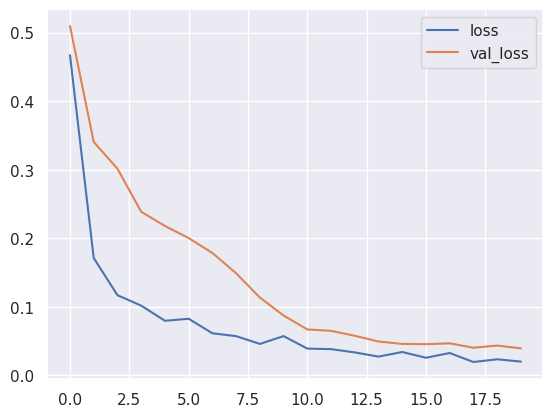

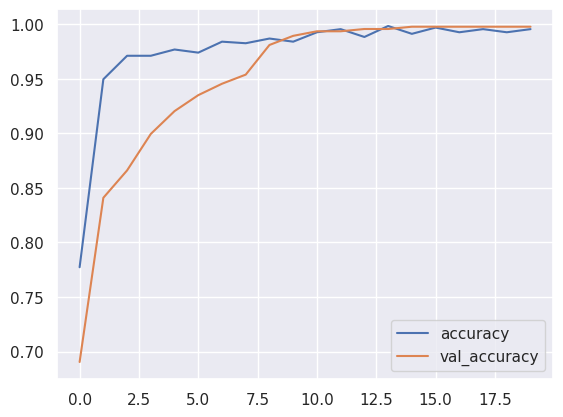

In [ ]:
model_history_2 = pd.DataFrame(history_2.history)
model_history_2.loc[:, ['loss', 'val_loss']].plot()
model_history_2.loc[:, ['accuracy', 'val_accuracy']].plot()

In [ ]:
print('Accuracy for Train: {:.4f}'.format(model_history_2['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(model_history_2['loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(model_history_2['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(model_history_2['val_loss'].mean()))

Accuracy for Train: 0.9750
Loss for Train: 0.0767
Accuracy for Test: 0.9495
Loss for Test: 0.1419


In [ ]:
start = time.time()
predict_labels_ = ensemble_method.predict(true_images)
duration = time.time() - start

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_1 = tf.reshape(true_labels, (-1,))
loss = loss_object(true_labels_1,predict_labels_)

predict_labels_2 = np.argmax(ensemble_method.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_2)))
print("Loss: {:0.4f}".format(loss))
print("Inference Time: {:.2f}s".format(duration))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_2)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_2)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_2)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_2)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_2)))

Accuracy: 1.0000
Loss: 0.0429
Inference Time: 4.20s
Precision: 1.0000
Recall: 1.0000
F1-Score: 1.0000
AUC: 1.0000
MCC: 1.0000


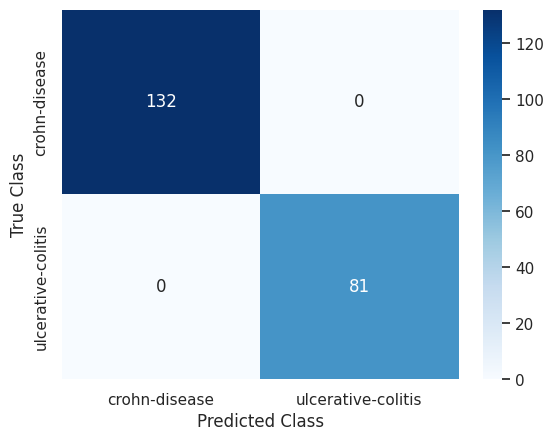

In [ ]:
conf_matrix_2 = pd.DataFrame(confusion_matrix(true_labels, predict_labels_2), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_2, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [ ]:
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)

  preds = ensemble_method.predict(img_array)
  if np.argmax(preds, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

ulcerative-colitis
crohn-disease
ulcerative-colitis
ulcerative-colitis
crohn-disease
crohn-disease


<h1>Knowledge Distillation</h1>

In [ ]:
distillation_ = Distiller(student=student_model, teacher=ensemble_method)

distillation_.compile(
    optimizer=Adam(learning_rate=1e-4),
    metrics=['accuracy'],
    student_loss_fn=SparseCategoricalCrossentropy(from_logits=True), 
    distillation_loss_fn=KLDivergence(),
    alpha=0.8,
    temperature=105)

In [ ]:
distillation_history = distillation_.fit(train_ds, epochs=100, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/100
23/23 [==============================] - 19s 533ms/step - accuracy: 0.6221 - student_loss: 0.6592 - distillation_loss: 9.0987 - val_accuracy: 0.4331 - val_student_loss: 0.6504
Epoch 2/100
23/23 [==============================] - 9s 355ms/step - accuracy: 0.7227 - student_loss: 0.5112 - distillation_loss: 8.9448 - val_accuracy: 0.4351 - val_student_loss: 0.6054
Epoch 3/100
23/23 [==============================] - 8s 343ms/step - accuracy: 0.8017 - student_loss: 0.4465 - distillation_loss: 8.7904 - val_accuracy: 0.4435 - val_student_loss: 0.4050
Epoch 4/100
23/23 [==============================] - 9s 351ms/step - accuracy: 0.9095 - student_loss: 0.2932 - distillation_loss: 7.0063 - val_accuracy: 0.4079 - val_student_loss: 1.9704e-05
Epoch 5/100
23/23 [==============================] - 9s 392ms/step - accuracy: 0.9655 - student_loss: 0.1189 - distillation_loss: 3.0250 - val_accuracy: 0.4582 - val_student_loss: 2.3341e-04
Epoch 6/100
23/23 [==============================] - 9s 

<Axes: >

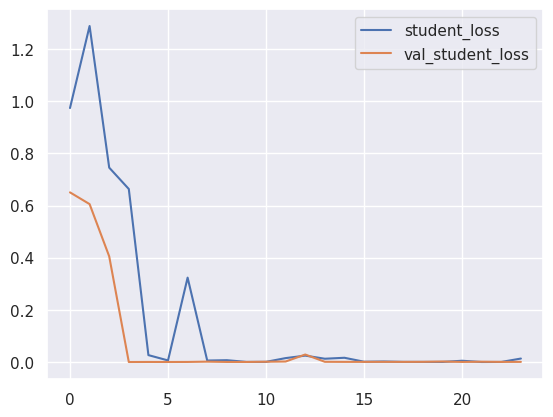

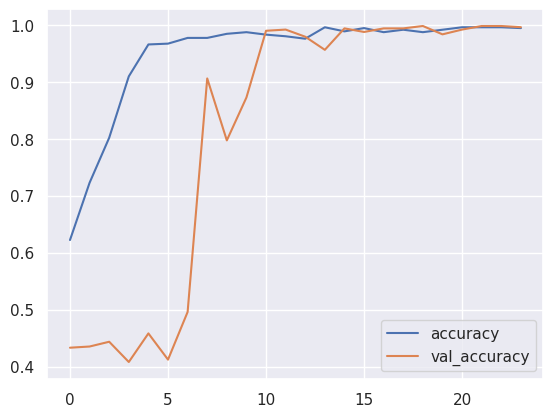

In [ ]:
distiller_history = pd.DataFrame(distillation_history.history)
distiller_history.loc[:, ['student_loss', 'val_student_loss']].plot()
distiller_history.loc[:, ['accuracy', 'val_accuracy']].plot()

In [ ]:
print('Accuracy for Train: {:.4f}'.format(distiller_history['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(distiller_history['student_loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(distiller_history['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(distiller_history['val_student_loss'].mean()))

Accuracy for Train: 0.9487
Loss for Train: 0.1721
Accuracy for Test: 0.8129
Loss for Test: 0.0710


In [ ]:
start_dist = time.time()
predict_labels_dist = distillation_.predict(true_images)
duration_dist = time.time() - start_dist

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_dist = tf.reshape(true_labels, (-1,))
loss_dist = loss_object(true_labels_dist,predict_labels_dist)

predict_labels_distiller = np.argmax(distillation_.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_distiller)))
print("Loss: {:0.4f}".format(loss_dist))
print("Inference Time: {:.2f}s".format(duration_dist))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_distiller)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_distiller)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_distiller)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_distiller)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_distiller)))

Accuracy: 0.9953
Loss: 0.0476
Inference Time: 1.69s
Precision: 0.9878
Recall: 1.0000
F1-Score: 0.9939
AUC: 0.9962
MCC: 0.9901


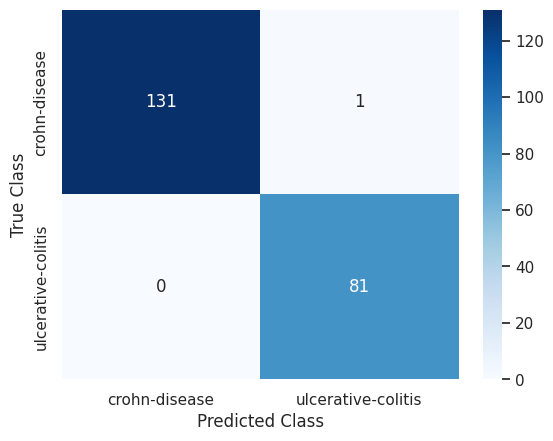

In [ ]:
conf_matrix_distiller = pd.DataFrame(confusion_matrix(true_labels, predict_labels_distiller), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_distiller, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [ ]:
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)

  preds_dist = distillation_.predict(img_array)
  if np.argmax(preds_dist, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')


ulcerative-colitis
crohn-disease
ulcerative-colitis
ulcerative-colitis
crohn-disease
crohn-disease


<h1>Interpretability of Teacher</h1>

<h3>Grad-Cam</h3>

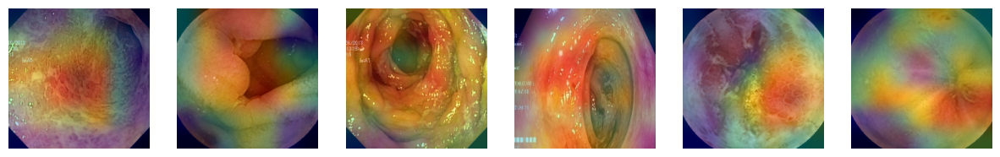

In [ ]:
last_conv_layer_name = "Conv_1"

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)

  ensemble_method.layers[-1].activation = None

  preds = ensemble_method.predict(img_array)
  heatmap = make_gradcam_heatmap_CNN(img_array, ensemble_method, last_conv_layer_name)

  heatmap = np.reshape(heatmap, (-1,7))
  display_gradcam(_images, heatmap, preds=preds[0], plot=ax)

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

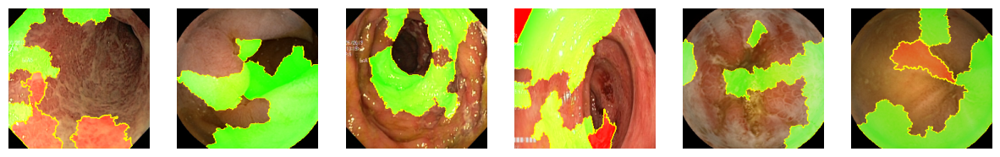

In [ ]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)
    
  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), ensemble_method.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>Shapley Values</h3>

`tf.keras.backend.set_learning_phase` is deprecated and will be removed after 2020-10-11. To update it, simply pass a True/False value to the `training` argument of the `__call__` method of your layer or model.


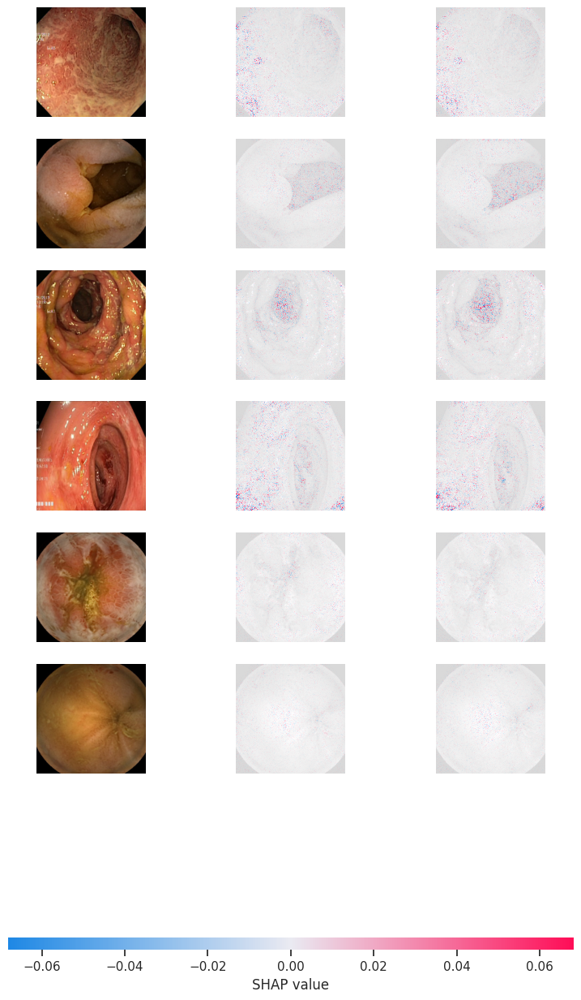

In [ ]:
images_train, labels_train = tuple(zip(*train_ds))
images_train_1 = np.concatenate(images_train)

shap_values = shap.GradientExplainer(ensemble_method, images_train_1).shap_values(image_interpretability_4)
shap.image_plot(shap_values, image_interpretability_4)

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [ ]:
model_rise = RISE(1000, 8, 0.5, ensemble_method, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:02<00:00, 408.97it/s]


Explaining: 100%|██████████| 32/32 [00:06<00:00,  5.32it/s]


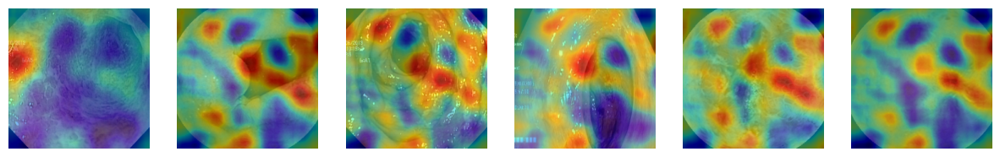

In [ ]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_4[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

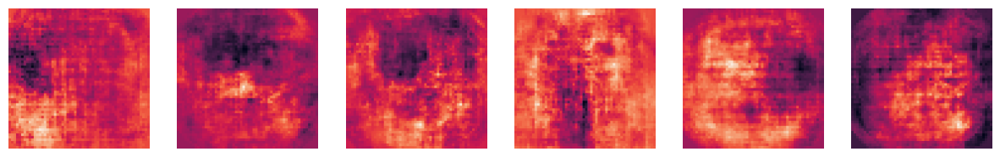

In [ ]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap = occ.get_heatmap(ensemble_method, 4, int(labels_interpretability_4[idx]), IMG_SIZE[0])

  ax.imshow(heatmap)
  ax.axis('off')

  idx += 1

<h1>Interpretability of Student</h1>

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

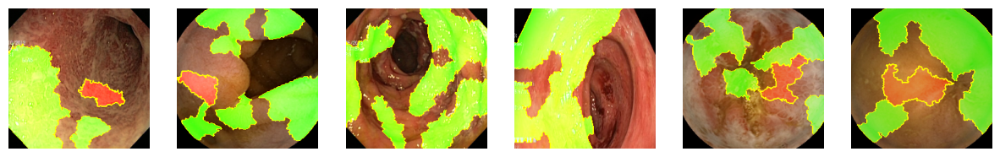

In [ ]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)
    
  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), distillation_.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [ ]:
model_rise = RISE(1000, 8, 0.5, distillation_, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:02<00:00, 411.51it/s]


Explaining: 100%|██████████| 32/32 [00:03<00:00,  8.40it/s]


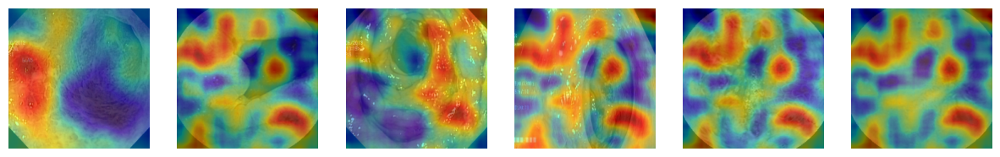

In [ ]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_4[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

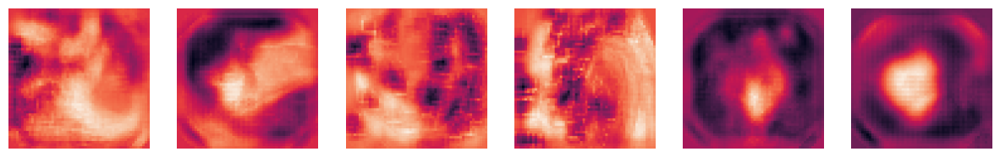

In [ ]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap = occ.get_heatmap(distillation_, 4, int(labels_interpretability_4[idx]), IMG_SIZE[0])

  ax.imshow(heatmap)
  ax.axis('off')

  idx += 1

# CNN+LSTM

In [10]:
inputs = Input(shape=(224, 224, 3))
x = data_augmentation(inputs)
x = layers.Conv2D(filters=32, kernel_size=3, activation='relu', padding = 'same')(x)
x = layers.Conv2D(filters=32, kernel_size=3, activation='relu', padding = 'same')(x)
x = layers.BatchNormalization()(x)
x = layers.MaxPooling2D()(x)
x = layers.Conv2D(filters=64, kernel_size=3, activation='relu', padding = 'same')(x)
x = layers.Conv2D(filters=64, kernel_size=3, activation='relu', padding = 'same')(x)
x = layers.BatchNormalization()(x)
x = layers.MaxPooling2D()(x)
x = layers.Conv2D(filters=128, kernel_size=3, activation='relu', padding = 'same')(x)
x = layers.Conv2D(filters=128, kernel_size=3, activation='relu', padding = 'same')(x)
x = layers.MaxPooling2D()(x)
x = layers.Conv2D(filters=256, kernel_size=3, activation='relu', padding = 'same')(x)
x = layers.Conv2D(filters=256, kernel_size=3, activation='relu', padding = 'same')(x)
x = layers.MaxPooling2D()(x)
x = layers.TimeDistributed(layers.Flatten())(x)
x = layers.Dense(128, activation='relu')(x)
x = layers.Dense(128, activation='relu')(x)
x = layers.Dropout(0.5)(x)
x = layers.Dense(128, activation='relu')(x)
x = layers.LSTM(100, return_sequences=True)(x)
x = layers.LSTM(100, return_sequences=True)(x)
x = layers.LSTM(50)(x)
x = layers.Dense(180, activation='relu')(x)
x = layers.Dense(160, activation='relu')(x)
x = layers.Dropout(0.5)(x)
x = layers.Dense(160, activation='relu')(x)
x = layers.Dropout(0.5)(x)
outputs = layers.Dense(len(class_names), activation='softmax')(x)
hybrid_model = Model(inputs, outputs)

In [11]:
hybrid_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 sequential (Sequential)     (None, 224, 224, 3)       0         
                                                                 
 conv2d (Conv2D)             (None, 224, 224, 32)      896       
                                                                 
 conv2d_1 (Conv2D)           (None, 224, 224, 32)      9248      
                                                                 
 batch_normalization (BatchN  (None, 224, 224, 32)     128       
 ormalization)                                                   
                                                                 
 max_pooling2d (MaxPooling2D  (None, 112, 112, 32)     0         
 )                                                           

In [12]:
hybrid_model.compile(loss='sparse_categorical_crossentropy', optimizer=Adam(learning_rate=1e-5), metrics=['accuracy'])

In [13]:
history_hybrid_model = hybrid_model.fit(train_ds, epochs=200, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/200
23/23 [==============================] - 22s 467ms/step - loss: 0.6905 - accuracy: 0.4727 - val_loss: 0.6875 - val_accuracy: 0.4268
Epoch 2/200
23/23 [==============================] - 7s 294ms/step - loss: 0.6860 - accuracy: 0.4784 - val_loss: 0.6838 - val_accuracy: 0.4331
Epoch 3/200
23/23 [==============================] - 6s 237ms/step - loss: 0.6777 - accuracy: 0.5388 - val_loss: 0.6796 - val_accuracy: 0.4247
Epoch 4/200
23/23 [==============================] - 7s 277ms/step - loss: 0.6665 - accuracy: 0.6006 - val_loss: 0.6726 - val_accuracy: 0.4268
Epoch 5/200
23/23 [==============================] - 6s 239ms/step - loss: 0.6495 - accuracy: 0.6379 - val_loss: 0.6600 - val_accuracy: 0.4351
Epoch 6/200
23/23 [==============================] - 7s 251ms/step - loss: 0.6376 - accuracy: 0.7112 - val_loss: 0.6399 - val_accuracy: 0.5565
Epoch 7/200
23/23 [==============================] - 7s 287ms/step - loss: 0.6190 - accuracy: 0.7701 - val_loss: 0.6192 - val_accuracy: 0.654

<Axes: >

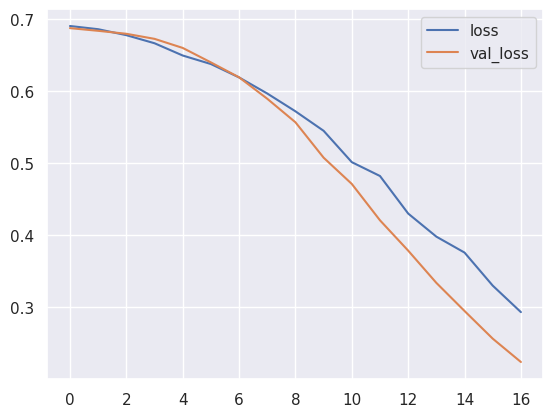

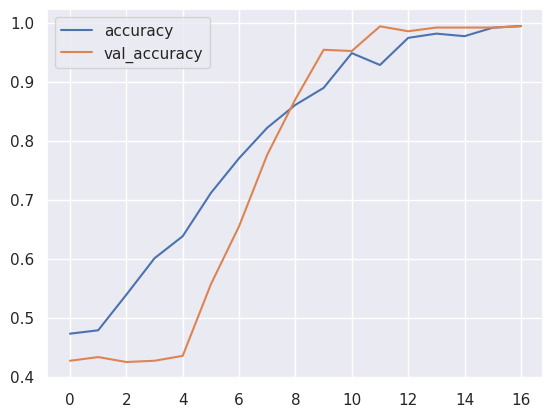

In [14]:
model_history_hybrid_model = pd.DataFrame(history_hybrid_model.history)
model_history_hybrid_model.loc[:, ['loss', 'val_loss']].plot()
model_history_hybrid_model.loc[:, ['accuracy', 'val_accuracy']].plot()

In [15]:
print('Accuracy for Train: {:.4f}'.format(model_history_hybrid_model['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(model_history_hybrid_model['loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(model_history_hybrid_model['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(model_history_hybrid_model['val_loss'].mean()))

Accuracy for Train: 0.7986
Loss for Train: 0.5382
Accuracy for Test: 0.7563
Loss for Test: 0.5102


In [16]:
start = time.time()
predict_labels_ = hybrid_model.predict(true_images)
duration = time.time() - start

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_1 = tf.reshape(true_labels, (-1,))
loss = loss_object(true_labels_1,predict_labels_)

predict_labels_hybrid_model = np.argmax(hybrid_model.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_hybrid_model)))
print("Loss: {:0.4f}".format(loss))
print("Inference Time: {:.2f}s".format(duration))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_hybrid_model)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_hybrid_model)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_hybrid_model)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_hybrid_model)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_hybrid_model)))

Accuracy: 0.9953
Loss: 0.4380
Inference Time: 2.31s
Precision: 1.0000
Recall: 0.9877
F1-Score: 0.9938
AUC: 0.9938
MCC: 0.9901


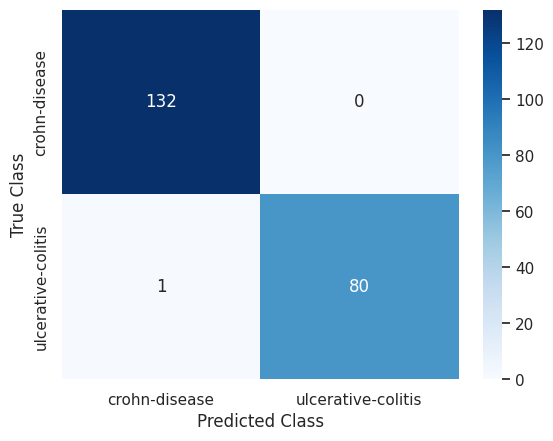

In [17]:
conf_matrix = pd.DataFrame(confusion_matrix(true_labels, predict_labels_hybrid_model), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [18]:
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)

  preds = hybrid_model.predict(img_array)
  if np.argmax(preds, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

ulcerative-colitis
crohn-disease
crohn-disease
ulcerative-colitis
crohn-disease
ulcerative-colitis


<h1>Interpretability</h1>

<h3>Grad-Cam</h3>

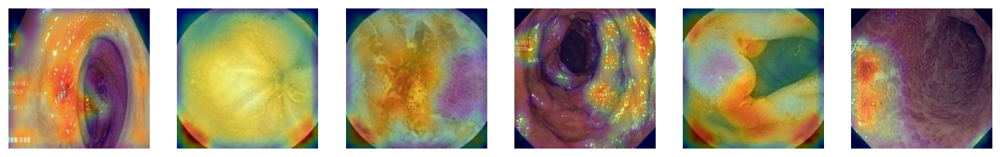

In [19]:
last_conv_layer_name = "conv2d_7"

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)

  hybrid_model.layers[-1].activation = None

  preds = hybrid_model.predict(img_array)
  heatmap = make_gradcam_heatmap_CNN(img_array, hybrid_model, last_conv_layer_name)

  heatmap = np.reshape(heatmap, (-1,28))
  display_gradcam(_images, heatmap, preds=preds[0], plot=ax)

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

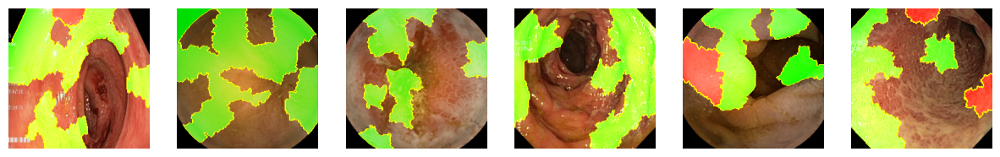

In [20]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)
    
  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), hybrid_model.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>Shapley Values</h3>

`tf.keras.backend.set_learning_phase` is deprecated and will be removed after 2020-10-11. To update it, simply pass a True/False value to the `training` argument of the `__call__` method of your layer or model.


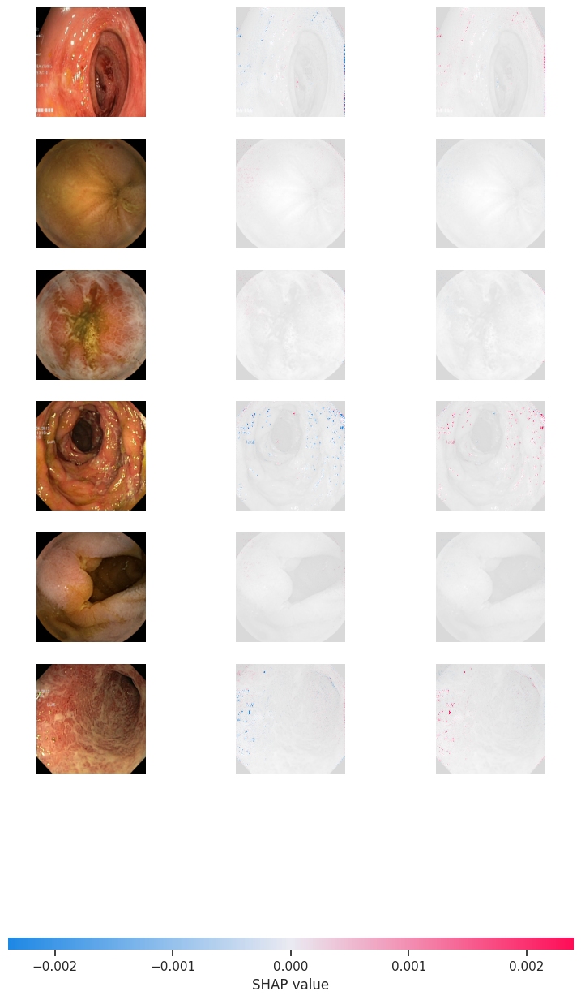

In [21]:
images_train, labels_train = tuple(zip(*train_ds))
images_train_1 = np.concatenate(images_train)

shap_values = shap.GradientExplainer(hybrid_model, images_train_1).shap_values(image_interpretability_4)
shap.image_plot(shap_values, image_interpretability_4)

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [22]:
model_rise = RISE(1000, 8, 0.5, hybrid_model, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:03<00:00, 284.57it/s]


Explaining: 100%|██████████| 32/32 [00:03<00:00, 10.06it/s]


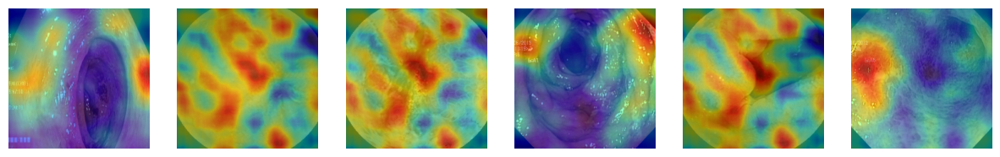

In [23]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_4[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

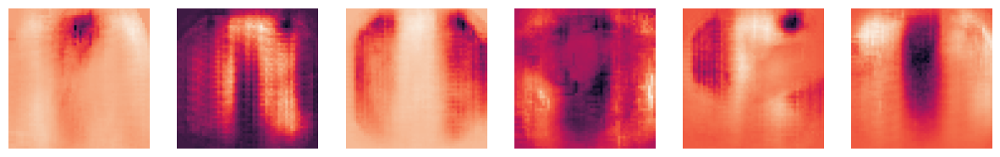

In [24]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap = occ.get_heatmap(hybrid_model, 4, int(labels_interpretability_4[idx]), IMG_SIZE[0])

  ax.imshow(heatmap)
  ax.axis('off')

  idx += 1